<a href="https://colab.research.google.com/github/nicolecosta/visaocomputacional/blob/main/resumao_pt2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **VISÃO COMPUTACIONAL - RESUMÃO PT2**

**NICOLE SARVASI ALVES DA COSTA**

#### <b>AULA 11- Morfologia Matemática</b>

A Morfologia Matemática (MM) é um modelo teórico para as imagens digitais construídas em cima da teoria dos reticulados e da topologia. É o fundamento do processamento de imagem morfológico, que é baseado nos operadores de deslocamento-invariante (translação invariante) baseados principalmente na adição de Minkowski.

#### <b>DILATAÇÃO BINÁRIA</b>

A dilatação, também as vezes chamada de dilação, é uma transformação morfológica que combina dois conjuntos usando adição vetorial. 

Em OpenCV, a operação de dilatação pode ser realizada da seguinte forma:

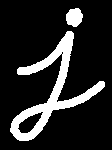

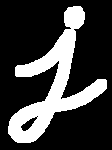

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")
kernel = np.ones((5,5),np.uint8)
dilation = cv.dilate(img,kernel,iterations = 1) #quanto mais iterações , mais dilatada a imagem
cv2_imshow(dilation)

FAZENDO CONTORNO COM A OPERAÇÃO DE DILATAÇÃO:

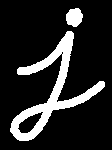

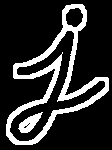

In [ ]:
import cv2 as cv
import numpy as np
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")
kernel = np.ones((3,3),np.uint8)
dilation = cv.dilate(img,kernel,iterations = 4)
cont=dilation-img
cv2_imshow(cont)

#### <b>EROSÃO BINÁRIA</b>

A erosão basicamente encolhe uma imagem e pode ser vista como uma transformação morfológica que combina dois conjuntos de vetores de subtração.

Em OpenCV, a operação de dilatação pode ser realizada da seguinte forma:

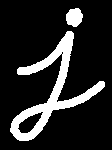

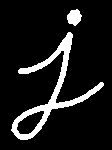

In [ ]:
import cv2 as cv
import numpy as np
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")
kernel = np.ones((3,3),np.uint8)
erosion = cv.erode(img,kernel,iterations = 1)
cv2_imshow(erosion)

FAZENDO CONTORNO COM A OPERAÇÃO DE EROSÃO:

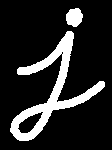

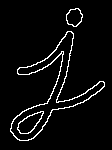

In [ ]:
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")
kernel = np.ones((3,3),np.uint8)
erosion = cv.erode(img,kernel,iterations = 1)
cont=img-erosion
cv2_imshow(cont)

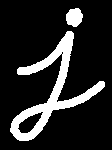

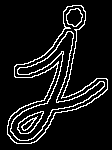

In [ ]:
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")
kernel = np.ones((3,3),np.uint8)
dilation = cv.dilate(img,kernel,iterations = 3)
dilationm = cv.dilate(img,kernel,iterations = 2)
dilation=dilation-dilationm
erosion = cv.erode(img,kernel,iterations = 1)
dupcont=dilation+(img-erosion)
cv2_imshow(dupcont)

A igualdade abaixo é não é válida:

(A ⊕ B)θ B = A

Combinando as operações de dilatação e erosão para obter um contorno mais grossoda imagem binária:

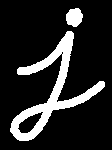

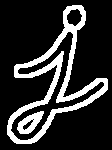

In [ ]:
import cv2 as cv
import numpy as np
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")


kernel = np.ones((3,3),np.uint8)
dilation = cv.dilate(img,kernel,iterations = 3)
erosion = cv.erode(img,kernel,iterations = 1)
dupcont=(dilation-img)+(img-erosion)
cv2_imshow(dupcont)

#### <b>ABERTURA BINÁRIA</b>

A abertura em geral suaviza o contorno de uma imagem, quebra estreitos e elimina proeminências delgadas, a operação de abertura é usada também para remover ruídos da imagem. 

Em OpenCV, a operação de abertura pode ser realizada de seguinte forma:

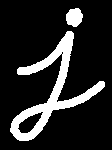

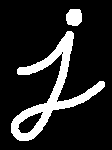

In [ ]:
import cv2 as cv
import numpy as np
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")
kernel = np.ones((5,5),np.uint8)
opening = cv.morphologyEx(img, cv.MORPH_OPEN, kernel)
cv2_imshow(opening)

#aplicar varias vezes melhora o resultado

#### <b>FECHAMENTO BINÁRIO</b>

O fechamento funde pequenas quebras e alarga golfos estreitos elimina pequenos orifícios. Se uma abertura cria pequenos vazios na imagem, um fechamento irá preencher ou fechar os vazios, estas operações podem remover muito dos pixels brancos com ruídos, ou seja, basicamente ele é igual a abertura só que que primeiramente é feita a dilatação e após é feita a erosão.

Em OpenCV, a operação de fechamento pode ser realizada da seguinte forma:

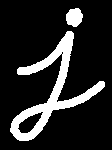

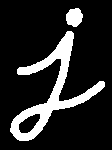

In [ ]:
import cv2 as cv
import numpy as np
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")
kernel = np.ones((5,5),np.uint8)
closing = cv.morphologyEx(img, cv.MORPH_CLOSE, kernel)
cv2_imshow(closing)

Aplicando a operação de fechamento várias vezes:

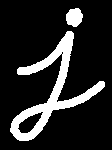

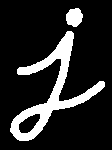

In [ ]:
import cv2 as cv
import numpy as np
img = cv.imread('j.png',0)
cv2_imshow(img)
print("")
kernel = np.ones((5,5),np.uint8)
closing = cv.morphologyEx(img, cv.MORPH_CLOSE, kernel)
closing = cv.morphologyEx(img, cv.MORPH_CLOSE, kernel)
cv2_imshow(closing)

## <b>AULA 12- Contornos e Tamanhos de Objetos</b>

Queremos obter os contornos e os tamanhos dos objetos abaixo.

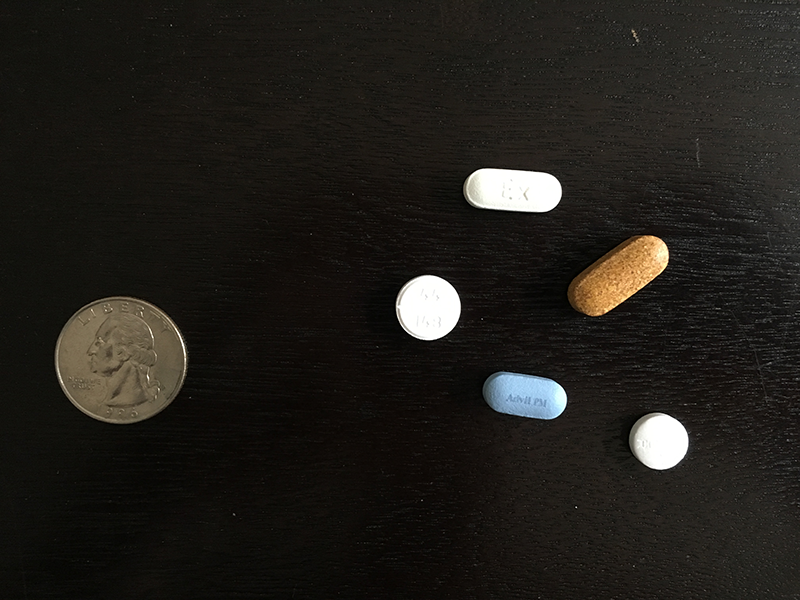

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
img = cv.imread('objects.png')
cv2_imshow(img)

#### <b>Primeiro Passo- Obtenção das Arestas</b>

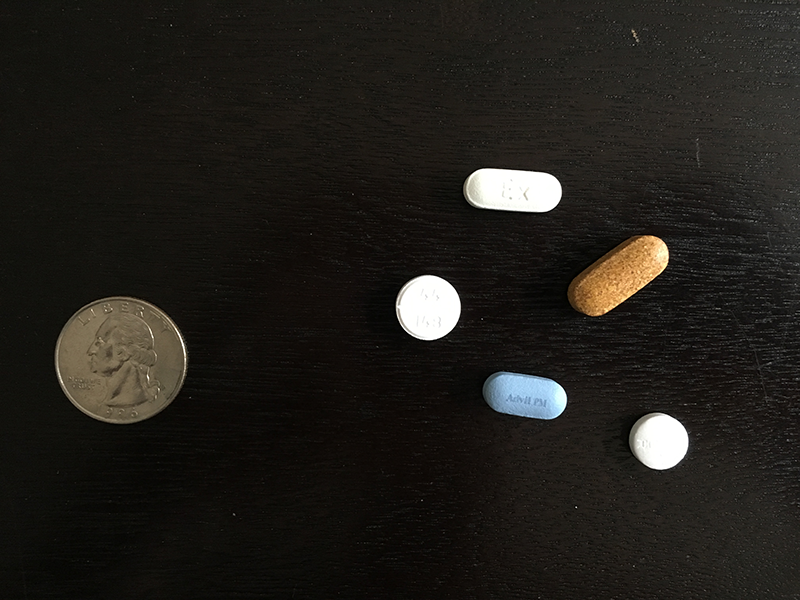

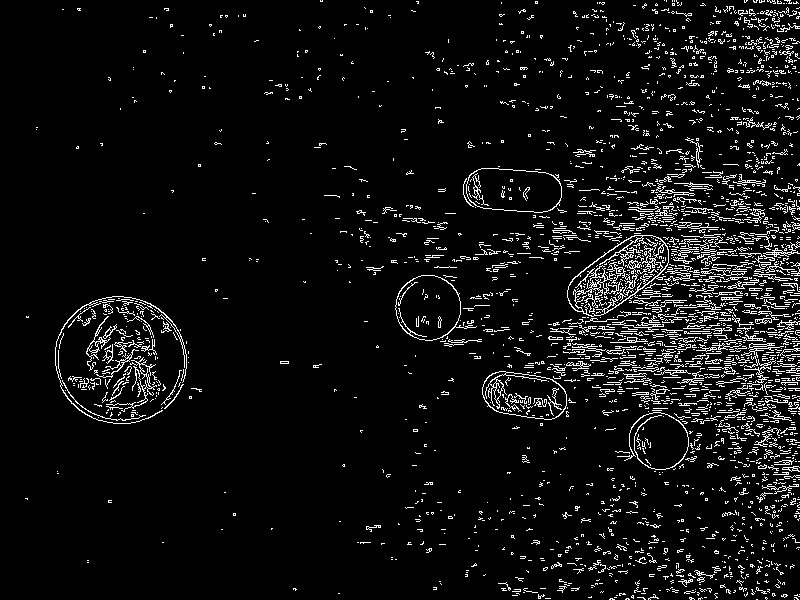

In [ ]:
image = cv.imread('objects.png')
cv2_imshow(image)
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
edged = cv.Canny(gray, 50, 100)
cv2_imshow(edged)

A seguir, temos um cálculo mais elaborado de arestas, que faz uso das operações morfológicas de erosão e dilatação vistas na última aula:

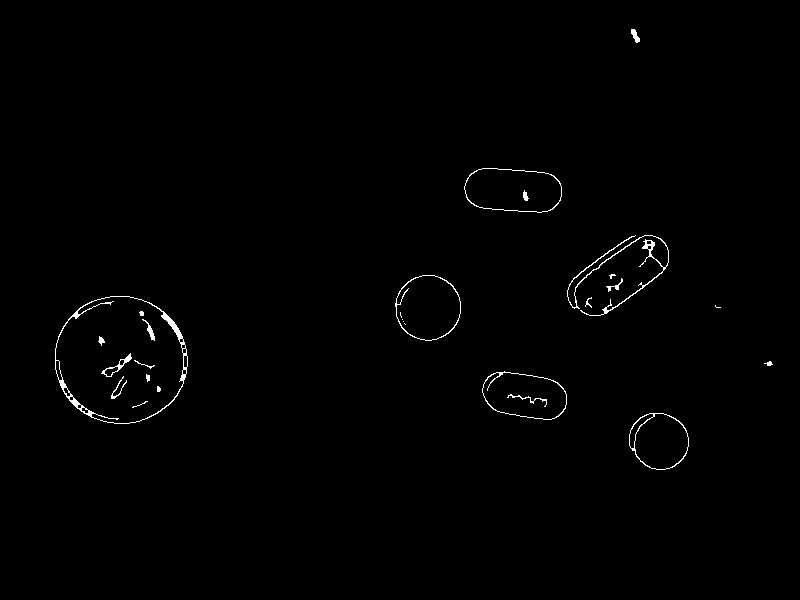

In [ ]:
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours

#carregamos a imagem, convertemos para níveis de cinza e a borramos levemente
image = cv.imread('objects.png')
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
gray = cv.GaussianBlur(gray, (7, 7), 0)

#calculamos as arestas e realizamos uma dilatação + erosão para fechar
#eventuais gaps entre as arestas dos objetos
edged = cv.Canny(gray, 50, 100)
edged = cv.dilate(edged, None, iterations=1)
edged = cv.erode(edged, None, iterations=1)
cv2_imshow(edged)

#### <b>Obtenção dos Contornos</b>

Para a obtenção dos contornos fazemos uso de módulos de utilitários para imagens (imutils).

In [ ]:
import imutils
from imutils import contours
cnts = cv.findContours(edged.copy(),cv.RETR_EXTERNAL,cv.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
(cnts, _) = contours.sort_contours(cnts)

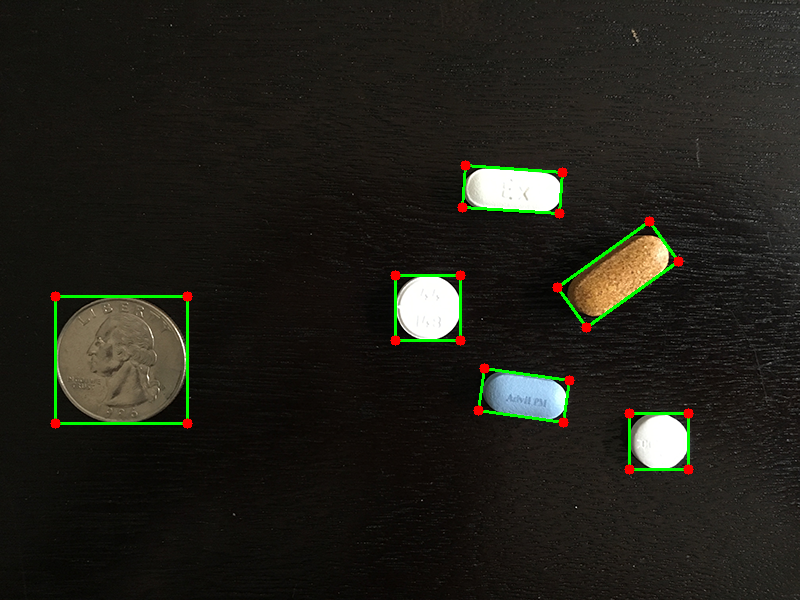

In [ ]:
from imutils import perspective
import numpy as np

orig = image.copy()

#Percorre todos os contornos
for c in cnts:
  # se o contorno não é suficientemente grande, ignorá-lo
  if cv.contourArea(c) < 100:
    continue
  # calcula a bounding box rotacionada do contorno
  box = cv.minAreaRect(c)
  box = cv.boxPoints(box) 
  box = np.array(box, dtype="int")
  #ordena os pontos do contorno de tal modo que eles
  #apareçam na seguinte ordem: topo-esquerda, topo-direita,
  #base-direita e base-esquerda
  box = perspective.order_points(box)
  cv.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
  for (x, y) in box:
    cv.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)
cv2_imshow(orig)


#### <b>Obtenção dos Pontos Médios</b>


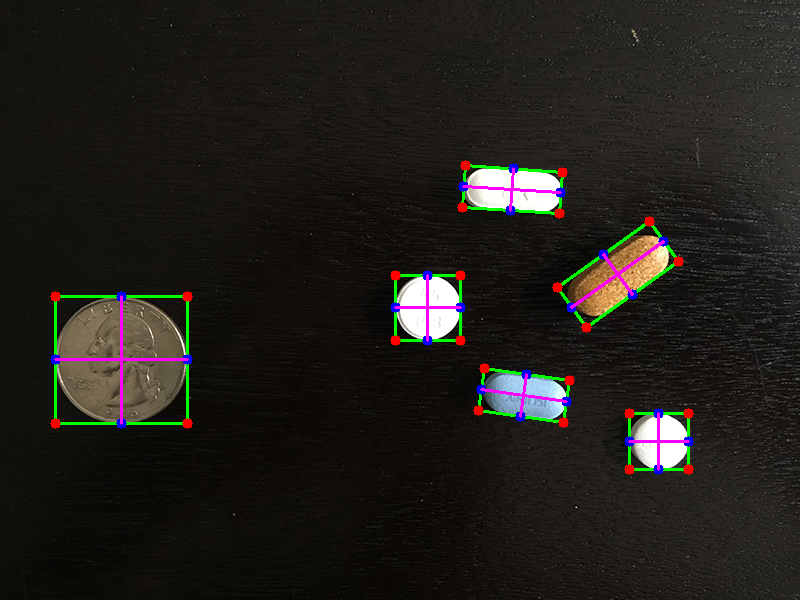

In [ ]:
from imutils import perspective
import numpy as np

def midpoint(ptA, ptB):
  return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

orig = image.copy()
#Percorre todos os contornos
for c in cnts:
  # se o contorno não é suficientemente grande, ignorá-lo
  if cv.contourArea(c) < 100:
    continue
  # calcula a bounding box rotacionada do contorno
  box = cv.minAreaRect(c)
  box = cv.boxPoints(box) 
  box = np.array(box, dtype="int")
  #ordena os pontos do contorno de tal modo que eles
  #apareçam na seguinte ordem: top-left, top-right,
  #bottom-right e bottom-left
  box = perspective.order_points(box)
  cv.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
  for (x, y) in box:
    cv.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)

  #obtém os pontos médios de top-left/top-right e bottom-left e bottom-right
  (tl, tr, br, bl) = box
  (tltrX, tltrY) = midpoint(tl, tr)
  (blbrX, blbrY) = midpoint(bl, br)
  
  #obtém os pontos médios de top-left/bottom-left e top-right e bottom-right
  (tlblX, tlblY) = midpoint(tl, bl)
  (trbrX, trbrY) = midpoint(tr, br)

  #desenha cículos nos pontos-médios
  cv.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)
  
  #une os pontos-médios com segmentos de reta
  cv.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
  cv.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)
cv2_imshow(orig)

#### <b>Obtenção das Medidas</b>

Para obter as medidas dos objetos, precisamos tomar um objeto de referência (ponto de calibração) de tamanho conhecido. Na imagem anterior, vamos tomar como medida de referência a moeda de dólar norte-americano, cujo comprimento é de 2.43 cm. A partir dela, definimos as outras medidas.

In [ ]:
#não temos como saber a quem este width esta se referindo especificamente, ele é referenciado como a moeda pelo número de pixels
width=2.43

pixelsPerMetric=None

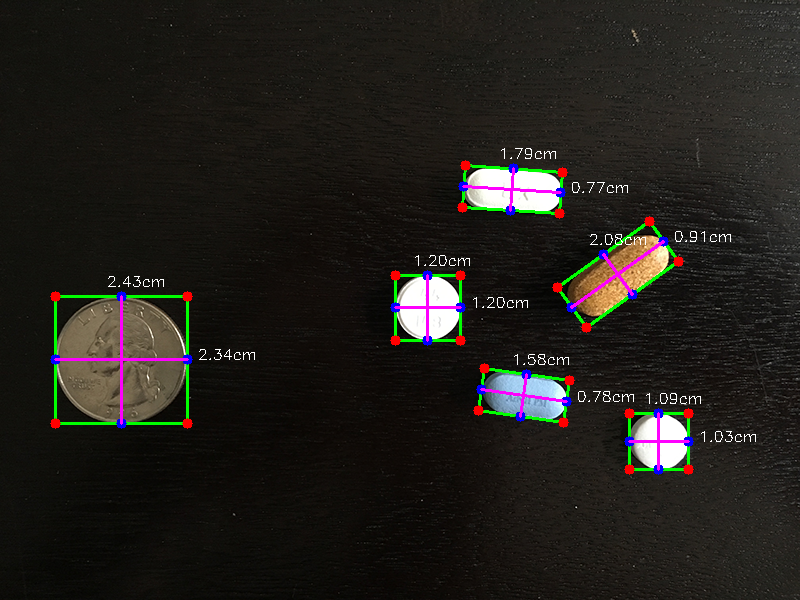

In [ ]:
from imutils import perspective
import numpy as np

def midpoint(ptA, ptB):
  return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

orig = image.copy()
#Percorre todos os contornos
for c in cnts:
  # se o contorno não é suficientemente grande, ignorá-lo
  if cv.contourArea(c) < 100:
    continue
  # calcula a bounding box rotacionada do contorno
  box = cv.minAreaRect(c)
  box = cv.boxPoints(box) 
  box = np.array(box, dtype="int")
  #ordena os pontos do contorno de tal modo que eles
  #apareçam na seguinte ordem: top-left, top-right,
  #bottom-right e bottom-left
  box = perspective.order_points(box)
  cv.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
  for (x, y) in box:
    cv.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)

  #obtém os pontos médios de top-left/top-right e bottom-left e bottom-right
  (tl, tr, br, bl) = box
  (tltrX, tltrY) = midpoint(tl, tr)
  (blbrX, blbrY) = midpoint(bl, br)
  
  #obtém os pontos médios de top-left/bottom-left e top-right e bottom-right
  (tlblX, tlblY) = midpoint(tl, bl)
  (trbrX, trbrY) = midpoint(tr, br)

  #desenha cículos nos pontos-médios
  cv.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)
  
  #une os pontos-médios com segmentos de reta
  cv.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
  cv.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)
  
  dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
  dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))
  
  if pixelsPerMetric is None:
    pixelsPerMetric = dB / width
  
  dimA = dA / pixelsPerMetric
  dimB = dB / pixelsPerMetric
  
  cv.putText(orig, "{:.2f}cm".format(dimB),(int(tltrX - 15), int(tltrY - 10)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
  cv.putText(orig, "{:.2f}cm".format(dimA),(int(trbrX + 10), int(trbrY)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
cv2_imshow(orig)


#### <b>Calculando a Área</b>
Calculando a área de cada uma das figuras presentes:

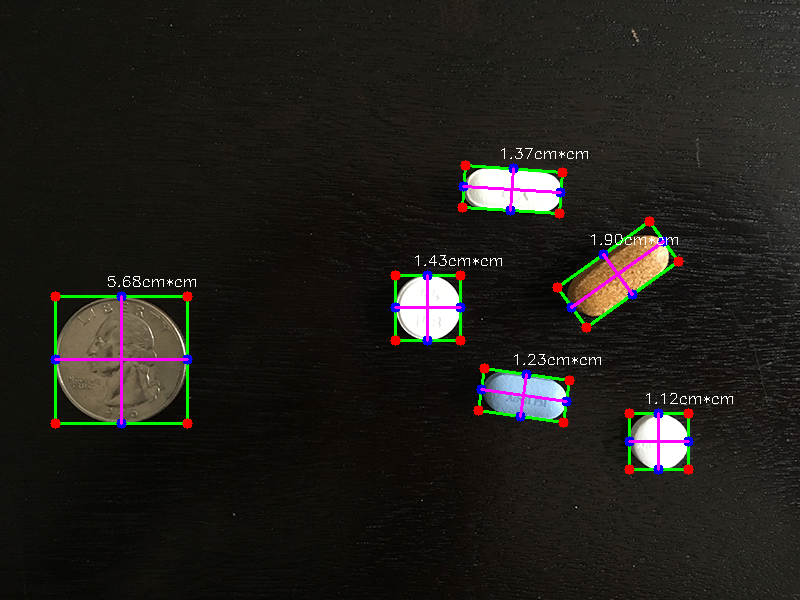

In [ ]:
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours
import imutils
from imutils import perspective
import numpy as np

#carregamos a imagem, convertemos para níveis de cinza e a borramos levemente
image = cv.imread('objects.png')
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
gray = cv.GaussianBlur(gray, (7, 7), 0)

#calculamos as arestas e realizamos uma dilatação + erosão para fechar
#eventuais gaps entre as arestas dos objetos
edged = cv.Canny(gray, 50, 100)
edged = cv.dilate(edged, None, iterations=1)
edged = cv.erode(edged, None, iterations=1)


cnts = cv.findContours(edged.copy(),cv.RETR_EXTERNAL,cv.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
(cnts, _) = contours.sort_contours(cnts)

width=2.43
pixelsPerMetric=None


def midpoint(ptA, ptB):
  return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

orig = image.copy()
#Percorre todos os contornos
for c in cnts:
  # se o contorno não é suficientemente grande, ignorá-lo
  if cv.contourArea(c) < 100:
    continue
  # calcula a bounding box rotacionada do contorno
  box = cv.minAreaRect(c)
  box = cv.boxPoints(box) 
  box = np.array(box, dtype="int")
  #ordena os pontos do contorno de tal modo que eles
  #apareçam na seguinte ordem: top-left, top-right,
  #bottom-right e bottom-left
  box = perspective.order_points(box)
  cv.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
  for (x, y) in box:
    cv.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)

  #obtém os pontos médios de top-left/top-right e bottom-left e bottom-right
  (tl, tr, br, bl) = box
  (tltrX, tltrY) = midpoint(tl, tr)
  (blbrX, blbrY) = midpoint(bl, br)
  
  #obtém os pontos médios de top-left/bottom-left e top-right e bottom-right
  (tlblX, tlblY) = midpoint(tl, bl)
  (trbrX, trbrY) = midpoint(tr, br)

  #desenha cículos nos pontos-médios
  cv.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)
  
  #une os pontos-médios com segmentos de reta
  cv.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
  cv.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)
  
  dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
  dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))
  
  if pixelsPerMetric is None:
    pixelsPerMetric = dB / width
  
  dimA = dA / pixelsPerMetric
  dimB = dB / pixelsPerMetric
  
  cv.putText(orig, "{:.2f}cm*cm".format(dimA*dimB),(int(tltrX - 15), int(tltrY - 10)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
  #cv.putText(orig, "{:.2f}cm".format(dimA),(int(trbrX + 10), int(trbrY)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
cv2_imshow(orig)


Melhorando a estimativa das áreas:

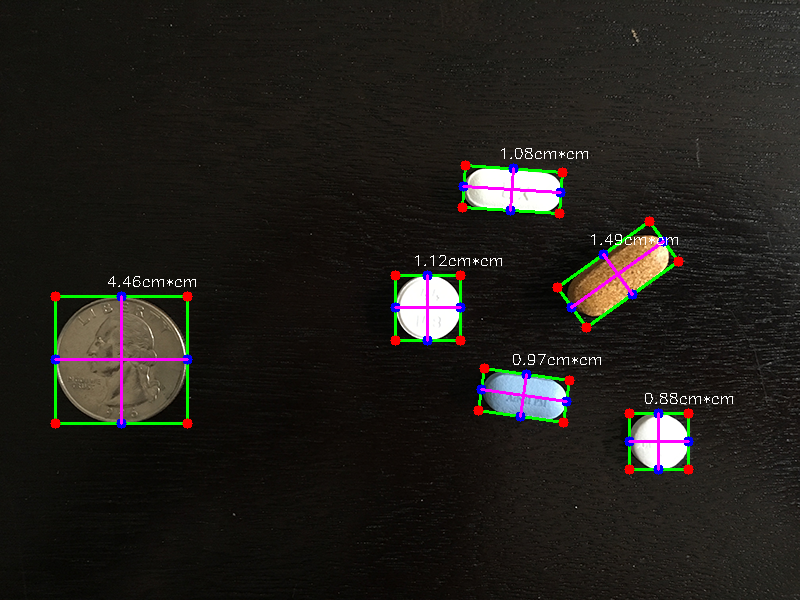

In [ ]:
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours
import imutils
from imutils import perspective
import numpy as np

#carregamos a imagem, convertemos para níveis de cinza e a borramos levemente
image = cv.imread('objects.png')
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
gray = cv.GaussianBlur(gray, (7, 7), 0)

#calculamos as arestas e realizamos uma dilatação + erosão para fechar
#eventuais gaps entre as arestas dos objetos
edged = cv.Canny(gray, 50, 100)
edged = cv.dilate(edged, None, iterations=1)
edged = cv.erode(edged, None, iterations=1)


cnts = cv.findContours(edged.copy(),cv.RETR_EXTERNAL,cv.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
(cnts, _) = contours.sort_contours(cnts)

width=2.43
pixelsPerMetric=None


def midpoint(ptA, ptB):
  return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

orig = image.copy()
#Percorre todos os contornos
for c in cnts:
  # se o contorno não é suficientemente grande, ignorá-lo
  if cv.contourArea(c) < 100:
    continue
  # calcula a bounding box rotacionada do contorno
  box = cv.minAreaRect(c)
  box = cv.boxPoints(box) 
  box = np.array(box, dtype="int")
  #ordena os pontos do contorno de tal modo que eles
  #apareçam na seguinte ordem: top-left, top-right,
  #bottom-right e bottom-left
  box = perspective.order_points(box)
  cv.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
  for (x, y) in box:
    cv.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)

  #obtém os pontos médios de top-left/top-right e bottom-left e bottom-right
  (tl, tr, br, bl) = box
  (tltrX, tltrY) = midpoint(tl, tr)
  (blbrX, blbrY) = midpoint(bl, br)
  
  #obtém os pontos médios de top-left/bottom-left e top-right e bottom-right
  (tlblX, tlblY) = midpoint(tl, bl)
  (trbrX, trbrY) = midpoint(tr, br)

  #desenha cículos nos pontos-médios
  cv.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)
  
  #une os pontos-médios com segmentos de reta
  cv.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
  cv.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)
  
  dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
  dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))
  
  if pixelsPerMetric is None:
    pixelsPerMetric = dB / width
  
  dimA = dA / pixelsPerMetric
  dimB = dB / pixelsPerMetric

  area=3.14*(dimA/2.0)*(dimB/2.0)
  
  cv.putText(orig, "{:.2f}cm*cm".format(area),(int(tltrX - 15), int(tltrY - 10)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
  #cv.putText(orig, "{:.2f}cm".format(dimA),(int(trbrX + 10), int(trbrY)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
cv2_imshow(orig)

#### <b>Obtenção de Perímetro</b>

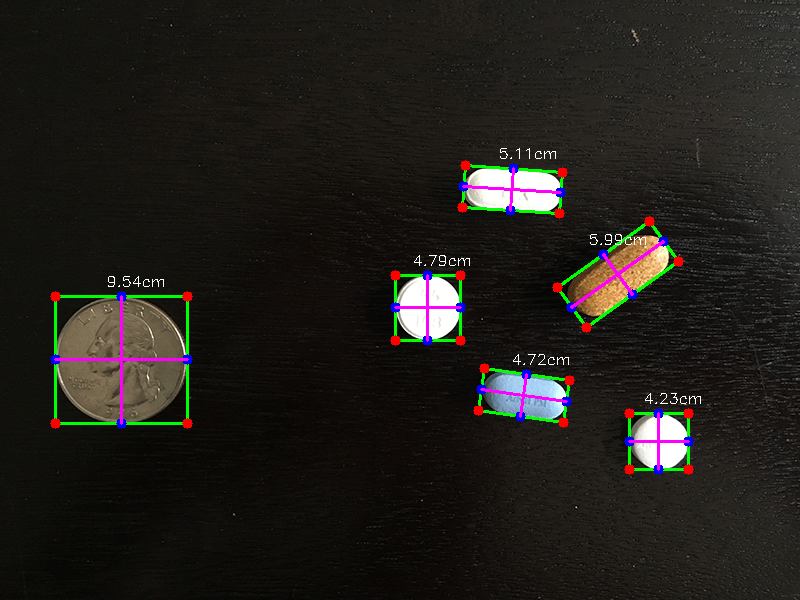

In [ ]:
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours
import imutils
from imutils import perspective
import numpy as np

#carregamos a imagem, convertemos para níveis de cinza e a borramos levemente
image = cv.imread('objects.png')
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
gray = cv.GaussianBlur(gray, (7, 7), 0)

#calculamos as arestas e realizamos uma dilatação + erosão para fechar
#eventuais gaps entre as arestas dos objetos
edged = cv.Canny(gray, 50, 100)
edged = cv.dilate(edged, None, iterations=1)
edged = cv.erode(edged, None, iterations=1)


cnts = cv.findContours(edged.copy(),cv.RETR_EXTERNAL,cv.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
(cnts, _) = contours.sort_contours(cnts)

width=2.43
pixelsPerMetric=None


def midpoint(ptA, ptB):
  return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

orig = image.copy()
#Percorre todos os contornos
for c in cnts:
  # se o contorno não é suficientemente grande, ignorá-lo
  if cv.contourArea(c) < 100:
    continue
  # calcula a bounding box rotacionada do contorno
  box = cv.minAreaRect(c)
  box = cv.boxPoints(box) 
  box = np.array(box, dtype="int")
  #ordena os pontos do contorno de tal modo que eles
  #apareçam na seguinte ordem: top-left, top-right,
  #bottom-right e bottom-left
  box = perspective.order_points(box)
  cv.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
  for (x, y) in box:
    cv.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)

  #obtém os pontos médios de top-left/top-right e bottom-left e bottom-right
  (tl, tr, br, bl) = box
  (tltrX, tltrY) = midpoint(tl, tr)
  (blbrX, blbrY) = midpoint(bl, br)
  
  #obtém os pontos médios de top-left/bottom-left e top-right e bottom-right
  (tlblX, tlblY) = midpoint(tl, bl)
  (trbrX, trbrY) = midpoint(tr, br)

  #desenha cículos nos pontos-médios
  cv.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)
  
  #une os pontos-médios com segmentos de reta
  cv.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
  cv.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)
  
  dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
  dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))
  
  if pixelsPerMetric is None:
    pixelsPerMetric = dB / width
  
  dimA = dA / pixelsPerMetric
  dimB = dB / pixelsPerMetric
  
  cv.putText(orig, "{:.2f}cm".format(2*(dimA+dimB)),(int(tltrX - 15), int(tltrY - 10)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
  #cv.putText(orig, "{:.2f}cm".format(dimA),(int(trbrX + 10), int(trbrY)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
cv2_imshow(orig)

Melhorando a estimativa dos perímetrs:

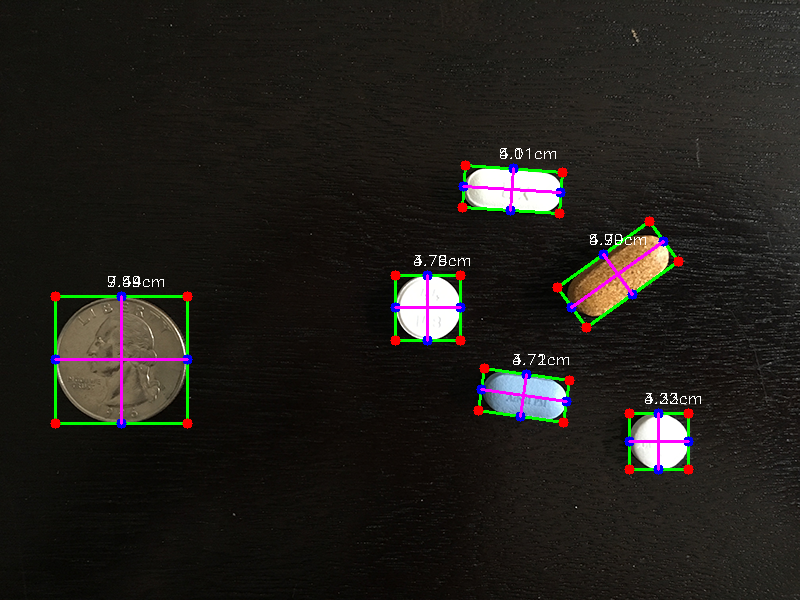

In [ ]:
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours
import imutils
from imutils import perspective
import numpy as np

#carregamos a imagem, convertemos para níveis de cinza e a borramos levemente
image = cv.imread('objects.png')
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
gray = cv.GaussianBlur(gray, (7, 7), 0)

#calculamos as arestas e realizamos uma dilatação + erosão para fechar
#eventuais gaps entre as arestas dos objetos
edged = cv.Canny(gray, 50, 100)
edged = cv.dilate(edged, None, iterations=1)
edged = cv.erode(edged, None, iterations=1)


cnts = cv.findContours(edged.copy(),cv.RETR_EXTERNAL,cv.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
(cnts, _) = contours.sort_contours(cnts)

width=2.43
pixelsPerMetric=None


def midpoint(ptA, ptB):
  return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

orig = image.copy()
#Percorre todos os contornos
for c in cnts:
  # se o contorno não é suficientemente grande, ignorá-lo
  if cv.contourArea(c) < 100:
    continue
  # calcula a bounding box rotacionada do contorno
  box = cv.minAreaRect(c)
  box = cv.boxPoints(box) 
  box = np.array(box, dtype="int")
  #ordena os pontos do contorno de tal modo que eles
  #apareçam na seguinte ordem: top-left, top-right,
  #bottom-right e bottom-left
  box = perspective.order_points(box)
  cv.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
  for (x, y) in box:
    cv.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)

  #obtém os pontos médios de top-left/top-right e bottom-left e bottom-right
  (tl, tr, br, bl) = box
  (tltrX, tltrY) = midpoint(tl, tr)
  (blbrX, blbrY) = midpoint(bl, br)
  
  #obtém os pontos médios de top-left/bottom-left e top-right e bottom-right
  (tlblX, tlblY) = midpoint(tl, bl)
  (trbrX, trbrY) = midpoint(tr, br)

  #desenha cículos nos pontos-médios
  cv.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)
  
  #une os pontos-médios com segmentos de reta
  cv.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
  cv.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)
  
  dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
  dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))
  
  if pixelsPerMetric is None:
    pixelsPerMetric = dB / width
  
  dimA = dA / pixelsPerMetric
  dimB = dB / pixelsPerMetric
  
  cv.putText(orig, "{:.2f}cm".format(2*dimA+2*dimB),(int(tltrX - 15), int(tltrY - 10)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
  
  
  
  
  
  
  cv.putText(orig, "{:.2f}cm".format(2*3.14*(dimA/2.0+dimB/2.0)/2.0),(int(tltrX - 15), int(tltrY - 10)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
  #cv.putText(orig, "{:.2f}cm".format(dimA),(int(trbrX + 10), int(trbrY)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
cv2_imshow(orig)

**EXERCÍCIO**

O objeto mais à esquerda na imagem abaixo possui um comprimento de 8.89cm. Estime o tamanho de cada um dos objetos desta imagem.


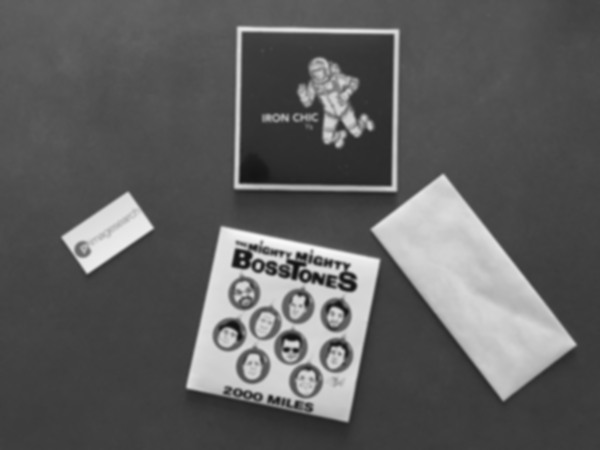

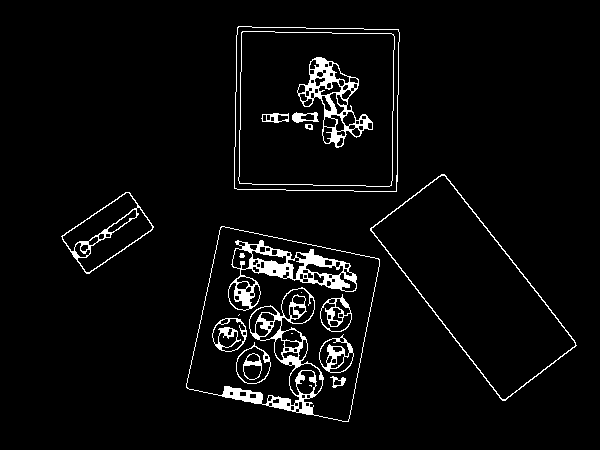

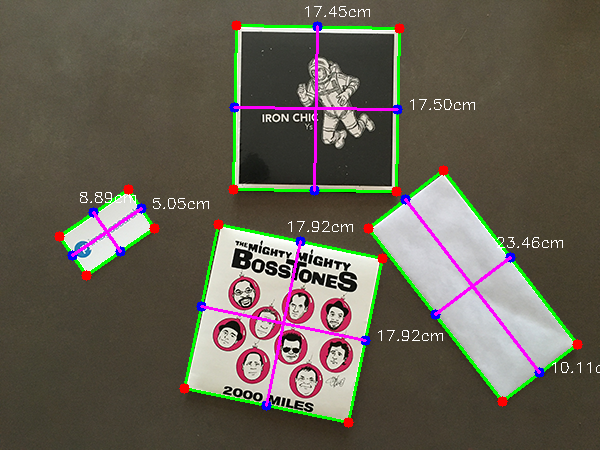

In [ ]:
from scipy.spatial import distance as dist
from imutils import perspective
from imutils import contours
import imutils
from imutils import perspective
import numpy as np

#carregamos a imagem, convertemos para níveis de cinza e a borramos levemente
image = cv.imread('objects2.png')
gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
gray = cv.GaussianBlur(gray, (7, 7), 0)

cv2_imshow(gray)

#calculamos as arestas e realizamos uma dilatação + erosão para fechar
#eventuais gaps entre as arestas dos objetos
edged = cv.Canny(gray, 50, 100)
edged = cv.dilate(edged, None, iterations=1)
edged = cv.erode(edged, None, iterations=1)

cv2_imshow(edged)

cnts = cv.findContours(edged.copy(),cv.RETR_EXTERNAL,cv.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
(cnts, _) = contours.sort_contours(cnts)

width=8.89

pixelsPerMetric=None


def midpoint(ptA, ptB):
  return ((ptA[0] + ptB[0]) * 0.5, (ptA[1] + ptB[1]) * 0.5)

orig = image.copy()
#Percorre todos os contornos
for c in cnts:
  # se o contorno não é suficientemente grande, ignorá-lo
  if cv.contourArea(c) < 100:
    continue
  # calcula a bounding box rotacionada do contorno
  box = cv.minAreaRect(c)
  box = cv.boxPoints(box) 
  box = np.array(box, dtype="int")
  #ordena os pontos do contorno de tal modo que eles
  #apareçam na seguinte ordem: top-left, top-right,
  #bottom-right e bottom-left
  box = perspective.order_points(box)
  cv.drawContours(orig, [box.astype("int")], -1, (0, 255, 0), 2)
  for (x, y) in box:
    cv.circle(orig, (int(x), int(y)), 5, (0, 0, 255), -1)

  #obtém os pontos médios de top-left/top-right e bottom-left e bottom-right
  (tl, tr, br, bl) = box
  (tltrX, tltrY) = midpoint(tl, tr)
  (blbrX, blbrY) = midpoint(bl, br)
  
  #obtém os pontos médios de top-left/bottom-left e top-right e bottom-right
  (tlblX, tlblY) = midpoint(tl, bl)
  (trbrX, trbrY) = midpoint(tr, br)

  #desenha cículos nos pontos-médios
  cv.circle(orig, (int(tltrX), int(tltrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(blbrX), int(blbrY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(tlblX), int(tlblY)), 5, (255, 0, 0), -1)
  cv.circle(orig, (int(trbrX), int(trbrY)), 5, (255, 0, 0), -1)
  
  #une os pontos-médios com segmentos de reta
  cv.line(orig, (int(tltrX), int(tltrY)), (int(blbrX), int(blbrY)),(255, 0, 255), 2)
  cv.line(orig, (int(tlblX), int(tlblY)), (int(trbrX), int(trbrY)),(255, 0, 255), 2)
  
  dA = dist.euclidean((tltrX, tltrY), (blbrX, blbrY))
  dB = dist.euclidean((tlblX, tlblY), (trbrX, trbrY))
  
  if pixelsPerMetric is None:
    pixelsPerMetric = dB / width
  
  dimA = dA / pixelsPerMetric
  dimB = dB / pixelsPerMetric
  
  cv.putText(orig, "{:.2f}cm".format(dimB),(int(tltrX - 15), int(tltrY - 10)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
  cv.putText(orig, "{:.2f}cm".format(dimA),(int(trbrX + 10), int(trbrY)), cv.FONT_HERSHEY_SIMPLEX,0.50, (255, 255, 255), 1)
cv2_imshow(orig)

## <b>AULA 13- TEMPLATE MATCHING</b>

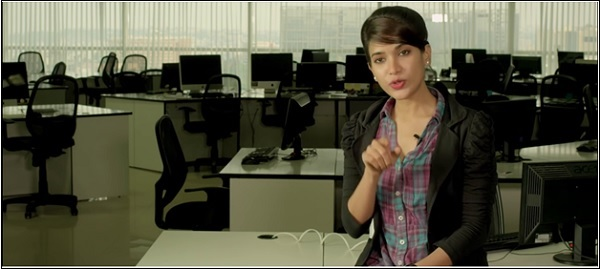

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
imagem = cv.imread('imagem.jpg')
cv2_imshow(imagem)

Nesta imagem, estamos interessados em encontrar a posição das mãos da mulher. Para isto, podemos definir um **template** para realizar a busca:

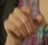

In [ ]:
template = cv.imread('template.png')
cv2_imshow(template)

A técnica de Template Matching (Casamento de Padrões) consiste de alguns passos básicos:

*   Converta a imagem onde será realizada a busca para níveis de cinza.
*   Converta o template também para níveis de cinza.
*   Percorra o template sobre cada posição da imagem, calculando o nível de acurácia (proximidade) de cada posição.
*   Quando o nível de acurácia for maior que um limite de acurácia estabelecido, marque esta posição como posição de detecção (match position). 

Abaixo, temos um exemplo de aplicação de Template Matching com a OpenCV em Python:

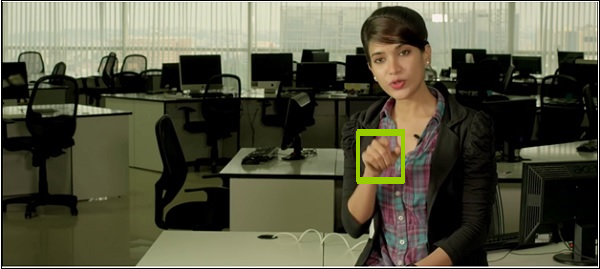

In [ ]:
import cv2 as cv
import numpy as np

#abre a imagem onde a busca será realizada e a converte para níveis de cinbza
main_image = cv.imread('imagem.jpg')
gray_image = cv.cvtColor(main_image, cv.COLOR_BGR2GRAY)
#abre o template e o converte para níveis de cinza
template = cv.cvtColor(cv.imread('template.png'), cv.COLOR_BGR2GRAY)
#comprimento e largura do template
width,height=template.shape
#template matching, que devolve o nível de acurácia
match = cv.matchTemplate(gray_image, template, cv.TM_CCOEFF_NORMED)
#obtém as posições onde o template gerou níveis de acurácia maiores que um limiar
threshold = 0.8
position = np.where(match >= threshold)
#desenha os retângulos com as regiões encontradas
for point in zip(*position[::-1]): 
   cv.rectangle(main_image, point, (point[0] + width, point[1] + height), (0, 204, 153), 0)
cv2_imshow(main_image)

## <b>AULA 16- CÂMERA PINHOLE/CALIBRAÇÃO/PROBLEMAS DE DISTORÇÃO</b>

Um dos elementos centrais no processo de geração de imagens são as câmeras. Imagens percebidas por uma câmera são projeções de objetos 3D no plano da imagem.

<img src="https://storage.googleapis.com/tensorflow-graphics/notebooks/intrinsics/camera_model.jpg"> </img>

A especificação de uma câmera consiste de parâmetros extrínsecos (posição, ponto focal) e intrínsecos (tamanho do plano de imagem, abertura, distância focal).

Uma câmera estenopeica ou câmera pinhole é uma máquina fotográfica sem lente. A designação tem por base o inglês, pin-hole, "buraco de alfinete" e é usada para referir a fotografia estenopeica. Este tipo de fotografia é uma prática econômica e simples pois utiliza uma caixa qualquer em que a luz não penetre. A existência de um pequeno furo (do grego stenós, estreito) é o que em português permite designar este tipo de fotografia por fotografia estenopeica.

A pinhole consiste numa maneira de ver uma imagem real através de uma câmara escura. De um pequeno orifício onde a luz é captada para dentro da câmara, e sofrendo um movimento de inversão, a imagem é projetada para a parede oposta ao orifício ao contrário. Para produzir uma imagem razoavelmente nítida, a abertura tem que ser um furo pequeno, na ordem de 0,5 mm ou menos. O obturador da câmara pinhole geralmente consiste de uma mão espalmada ou de algum material à prova de luz para cobrir e descobrir o furo. As câmaras pinhole requerem um tempo maior de exposição do que as câmaras convencionais, devido à pequena abertura; os tempos de exposição vão de 5 segundos a muitas horas.

<img src="https://lhoangan.github.io/assets/images/posts/2018-07-30/pinhole_camera.png"> </img>

A imagem pode ser projetada em uma tela translúcida para visualização em tempo real (popularmente utilizadas para ver eclipses solares), ou pode expor filme ou um dispositivo de carga acoplado (CCD). As câmaras pinhole com CCD são algumas vezes utilizadas em serviço de vigilância, devido a seu tamanho pequeno.

Os parâmetros do modelo de câmera pinhole são mostrados  abaixo:

<img src="https://lhoangan.github.io/assets/images/posts/2018-07-30/camera_model.png"> </img>

Podemos relacionar as coordenadas $(X,Y,Z)$ dos objetos com coordenadas $(u,v)$ na imagem usando a seguinte matriz de projeção:

<img src="https://visualservoing.files.wordpress.com/2012/04/pinhole-model-formula.jpg"> </img>

Nesta matriz, $(c_{x},c_{y})$ representa o centro do plano da imagem, chamado de centro focal e $(f_{x},f_{y})$ as distâncias focais (normalmente, assumimos que $f_{x}=f_{y}=f$. 


#### <b> EXERCÍCIO </b>

Suponha uma câmera pinhole posicionada na origem, com foco segundo o eixo z, com distância focal f=2 e centro focal (0,0). Obtenha as coordenadas do pixel no plano da imagem produzidas pelo ponto 3D de coordenadas (3,2,5).

In [ ]:
import numpy as np

camera=np.array([[2,0,0],
                 [0,2,0],
                 [0,0,1]])
ponto=np.array([3,2,5]);
Z=5
imagem=np.matmul(camera,ponto)/Z
imagem

array([1.2, 0.8, 1. ])

### <b> CALIBRAÇÃO DE CÂMERAS </b>

O <b> problema da calibração de câmera 3D </b> consiste em: dadas uma ou mais imagens de uma cena, encontrar o valor das parâmetros da matriz de projeção da câmera $c_{x},c_{y},f_{x},f_{y}$. No processo de calibração, podemos usar uma, duas, três ou mais imagens. 

Nesta aula, trablharemos apenas com uma imagem para calibração. Para isto, nos orientaremos pelas linhas do tabuleiro, conforme mostrado abaixo:

<img src="https://docs.opencv.org/3.4/calib_radial.jpg"> </img>

Devido à distorção das lentes, as linhas nem sempre estarão "retas". Posteriormente, vamos corrigir esta distorção.

No código abaixo, vamos identificar 42 (7x6) corners em cada imagem do tabuleiro para usarmos como referência na reconstrução da matriz de câmera.

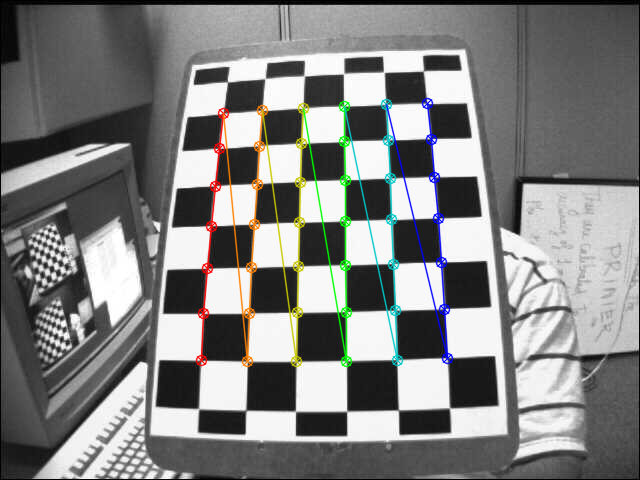

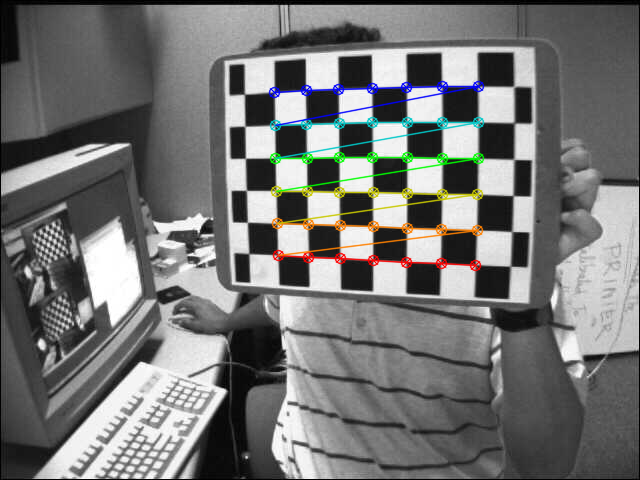

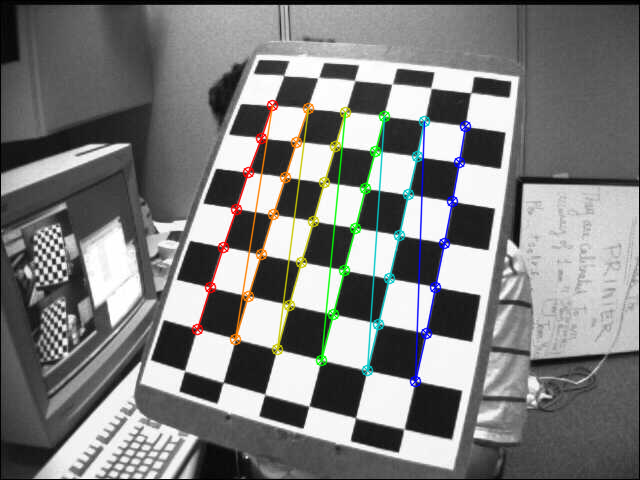

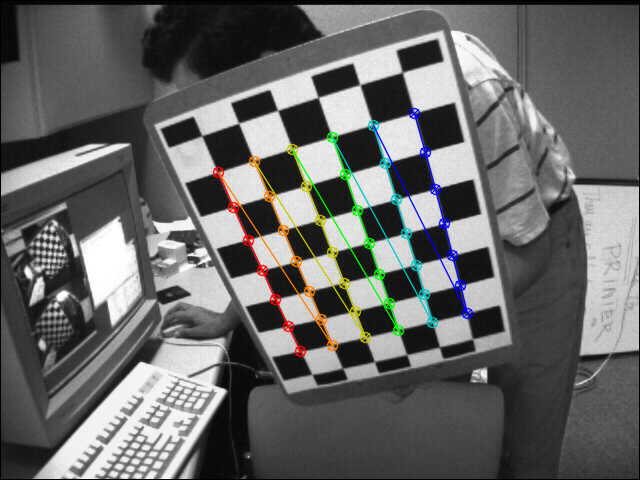

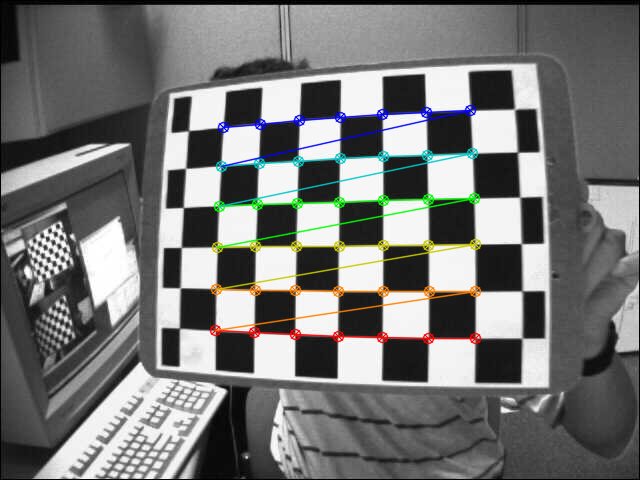

...

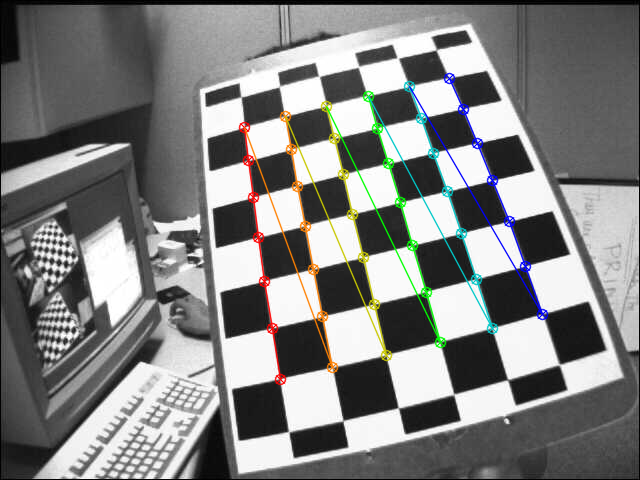

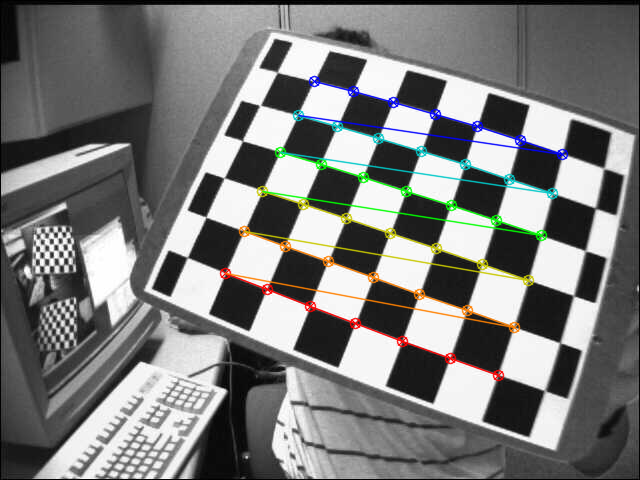

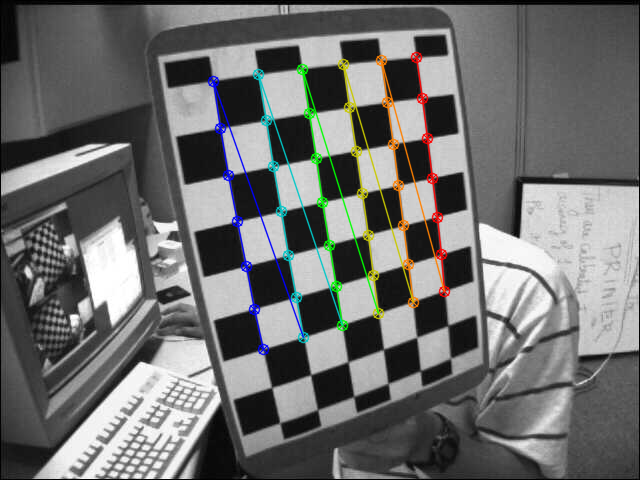

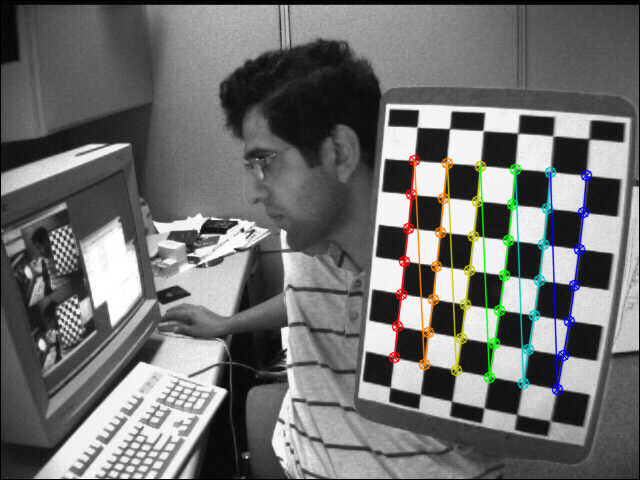

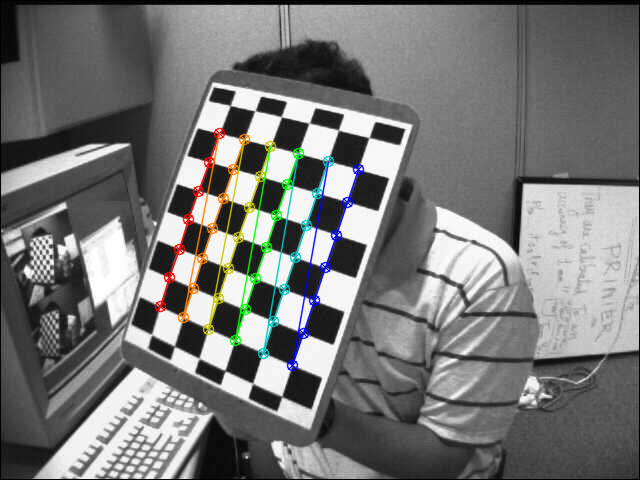

In [ ]:
import numpy as np
import cv2
import glob
from google.colab.patches import cv2_imshow



# pontos 3D (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*7,3), np.float32)
objp[:,:2] = np.mgrid[0:7,0:6].T.reshape(-1,2)

objpoints = [] # pontos 3D dos objetos
imgpoints = [] # pontos 3D das imagens

images = glob.glob('*.jpg')

for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Encontra 42 (7x6) corners no tabuleiro de xadrez
    ret, corners = cv2.findChessboardCorners(gray, (7,6),None)

    # Caso encontrados, adiciona pontos 3D e 2D nas listas objpoints e imgpoints
    # com refinamento da busca
    if ret == True:
        objpoints.append(objp)
        # critério de término de busca
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Desenha e mostra os corners nas diversas imagens
        img = cv2.drawChessboardCorners(img, (7,6), corners2,ret)
        cv2_imshow(img)


In [ ]:
_,mtx,_,_,_ = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
print('Matriz de câmera:')
print(mtx)

Matriz de câmera:
[[534.07088623   0.         341.53407107]
 [  0.         534.11914798 232.94565221]
 [  0.           0.           1.        ]]


### <b> CORREÇÃO DAS IMAGENS COM DISTORÇÃO DE LENTES </b>

Uma vez realizada uma calibração ótima, podemos corrigir a distorção de lentes nas imagens, deixando as linhas do tabuleiro "retas".

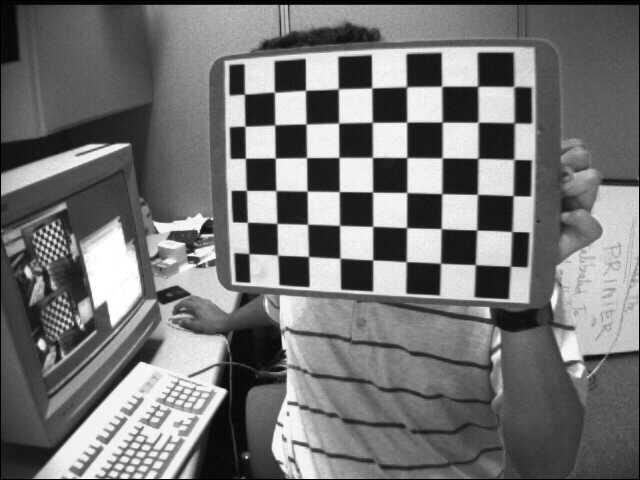

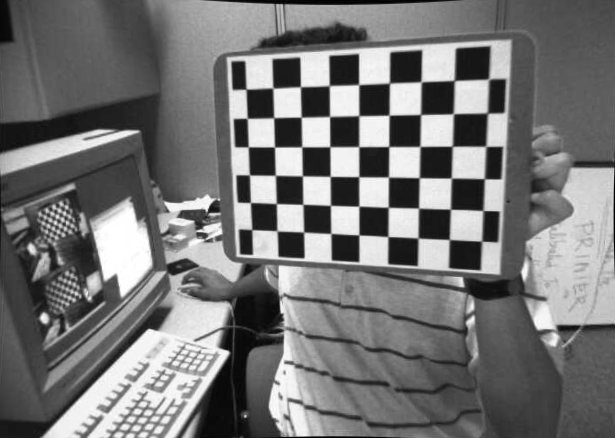

In [ ]:
_,mtx,dist,_,_ = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
img = cv2.imread('left01.jpg')
h, w = img.shape[:2]
newcameramtx,roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))

# corrige distorção
imgc = cv2.undistort(img, mtx, dist, None, newcameramtx)

# corta a imagem segundo o ROI recebido
x,y,w,h = roi
imgc = imgc[y:y+h, x:x+w]

cv2_imshow(img)
cv2_imshow(imgc)

#### <b>Corrigir Distorções e Armazenar em Disco</b>

Corrigir as distorções das treze imagens fornecidas, armazenando-as em disco.

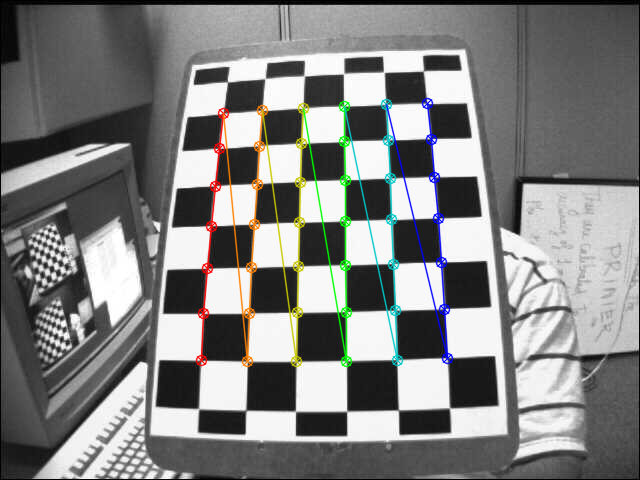

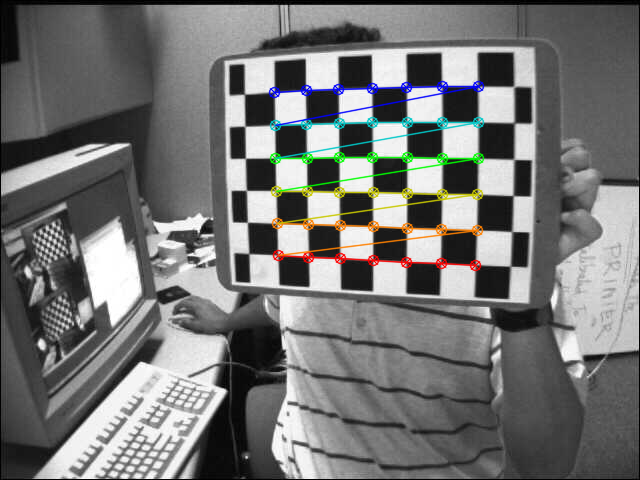

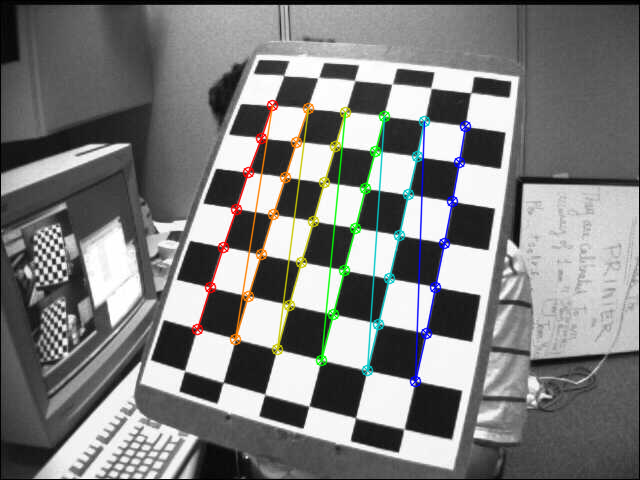

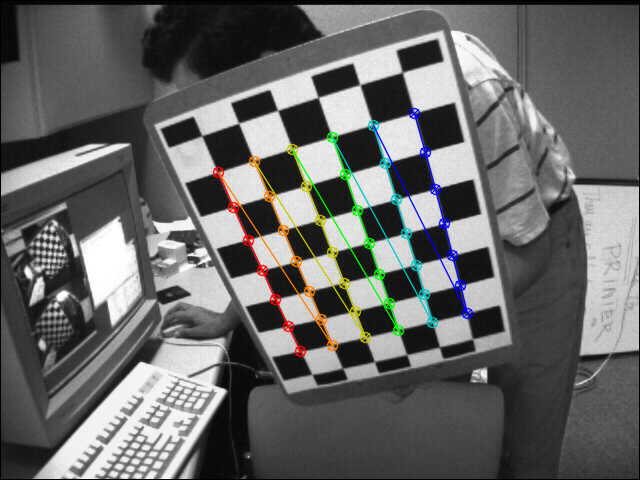

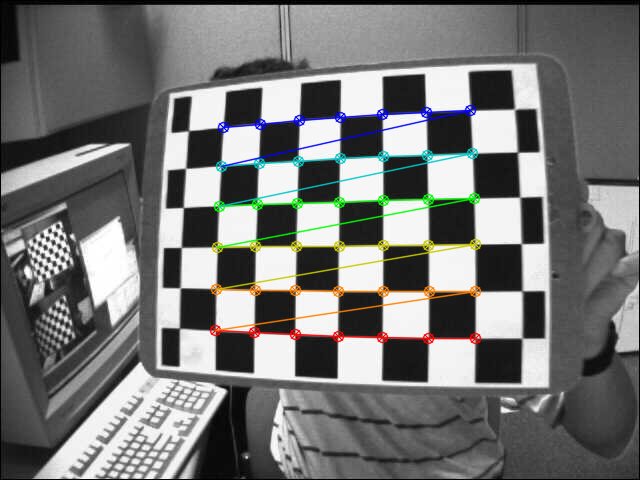

...

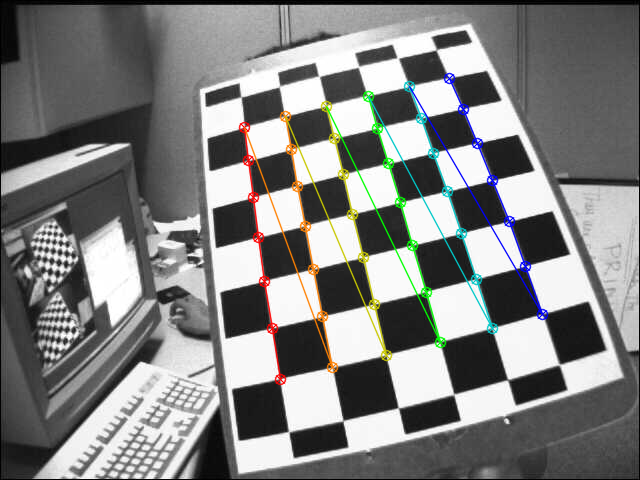

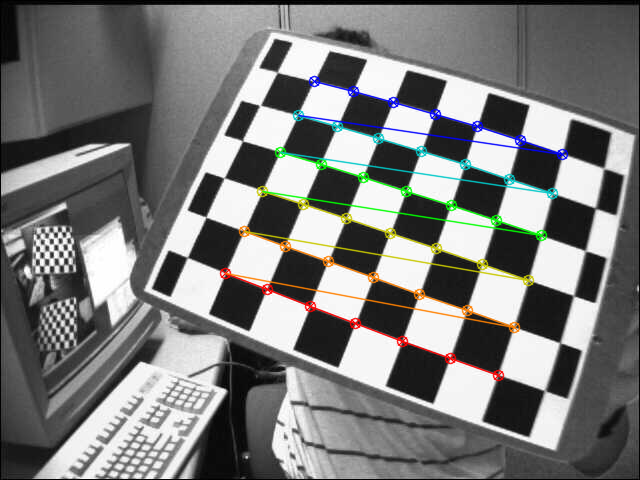

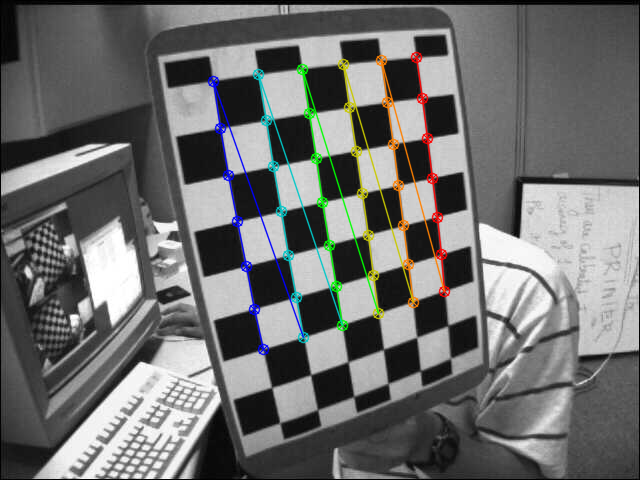

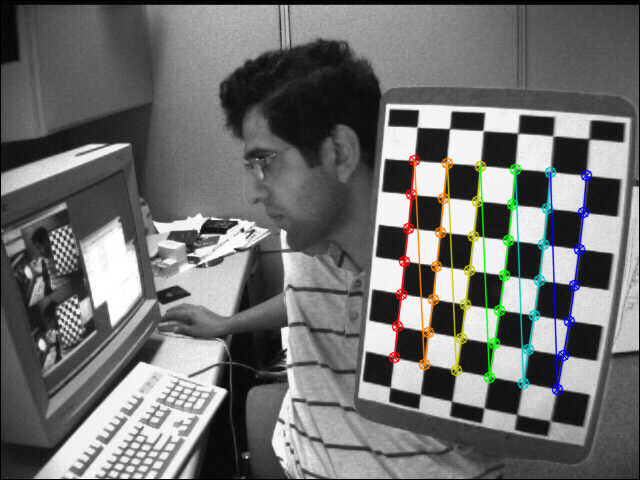

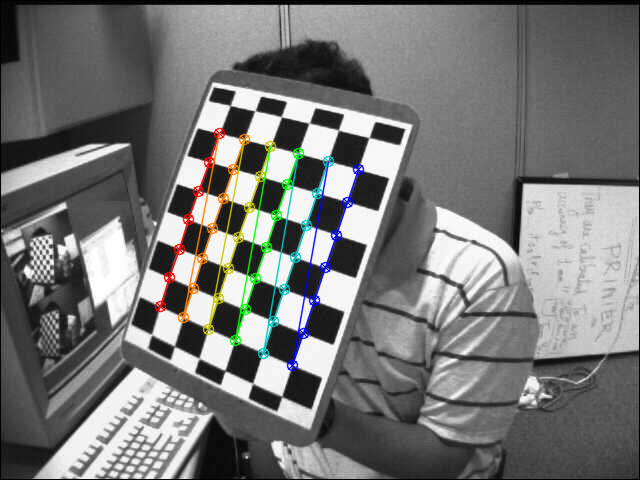

In [ ]:
# pontos 3D (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*7,3), np.float32)
objp[:,:2] = np.mgrid[0:7,0:6].T.reshape(-1,2)

objpoints = [] # pontos 3D dos objetos
imgpoints = [] # pontos 3D das imagens

images = glob.glob('*.jpg')

for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Encontra 42 (7x6) corners no tabuleiro de xadrez
    ret, corners = cv2.findChessboardCorners(gray, (7,6),None)

    # Caso encontrados, adiciona pontos 3D e 2D nas listas objpoints e imgpoints
    # com refinamento da busca
    if ret == True:
        objpoints.append(objp)
        # critério de término de busca
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Desenha e mostra os corners nas diversas imagens
        img = cv2.drawChessboardCorners(img, (7,6), corners2,ret)
        cv2_imshow(img)

In [ ]:
_,mtx,dist,_,_ = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
img = cv2.imread('left01.jpg')
h, w = img.shape[:2]
newcameramtx,roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))

In [ ]:
for fname in images:
  img = cv2.imread(fname)
  
  # corrige distorção
  imgc = cv2.undistort(img, mtx, dist, None, newcameramtx)
  cv2.imwrite(fname,imgc)

## **AULA 17 - FUNDAMENTOS DA VISÃO ESTÉREO E GEOMETRIA EPIPOLAR**

### <b> GEOMETRIA EPIPOLAR </b>

Quando trabalhamos com o modelo de câmera pinhole, perdemos uma noção importante: profundidade. Uma das maneiras para se perceber profundidade é com o uso de câmeras, conhecida como <b> Visão Estéreo</b>. 

<img src="https://opencv24-python-tutorials.readthedocs.io/en/latest/_images/epipolar.jpg"> </img>

Usando somente a câmera de centro <i>O</i>, temos várias possibilidades de pontos X que podem ser projetados no ponto x da imagem. Porém, se consideramos uma outra câmera <i>O'</i>, os pontos x' correspondentes aos pontos x levam a um único ponto X possível no espaço, que pode ser calculado através da intersecção das semiretas <i>Ox</i> e <i>O'x'</i>. 

As linhas <i>l</i> e <i>l'</i> são chamadas <b>linhas epipolares</b> e contém pontos correspondentes em projeção nas duas imagens, conhecidos como <b>epipolos</b>. O plano <i>OXO'</i> é chamado de <b>plano epipolar</b>.

Conhecidos os centros <i>O</i>, <i>O'</i> e alguns pares de epipolos <i>(e,e')</i> (normalmente, dependemos da técnica utilizada, usamos oito epipolos ou mais), é possível reconstruir as matrizes de projeção das câmeras <i>O</i> e <i>O'</i>. Esta determinação de matrizes é realizada com o auxílio da <b>Geometria Epipolar</b>.

Para simplificar o nosso modelo de duas câmeras, vamos considerar duas câmeras com os mesmos parâmetros intrínsecos (distância focal, tamanho do plano de projeção, dentre outros) e posicionadas diferentemente utilizando uma translação e uma rotação.

<img src="https://opencv24-python-tutorials.readthedocs.io/en/latest/_images/essential_matrix.jpg"> </img>

Vamos designar as matrizes das câmeras de <i>K</i> e <i>K'</i>, associadas aos centros <i>O</i> e <i>O'</i>, respectivamente. Para determinar estas duas matrizes, vamos duas outras matrizes: <b> Matriz Essencial (E)</b> e a <b> Matriz Fundamental(F) </b>.

A matriz essencial E contém informações sobre a translação T e a rotação R da câmera <i>O'</i>, em relação à câmera <i>O</i>. A matriz fundamental F permite projetar uma linha epipolar de imagem na linha epipolar correspodnente na outra imagem.


### <b> MATRIZ FUNDAMENTAL F </b>

A matriz fundamental F pode ser obtida resolvendo o sistema de equações lineares abaixo:

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/6ab25460ff5b12e37a92d4ad41487802476c69be"> </img>
</center>

A matriz F é uma matrix 3x3. Assim, 8 equações são suficientes para determiná-la completamente. Estas equações são obtidas através de 8 pares de epipolos <i>(e,e')</i> correspondentes nas duas imagens.

Imagem Esquerda


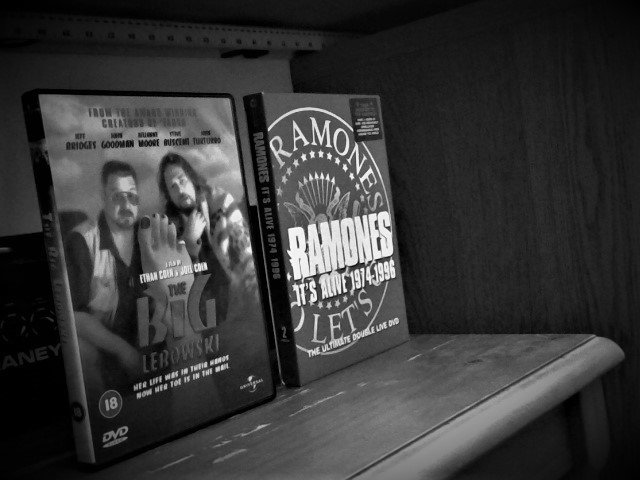

Imagem Direita


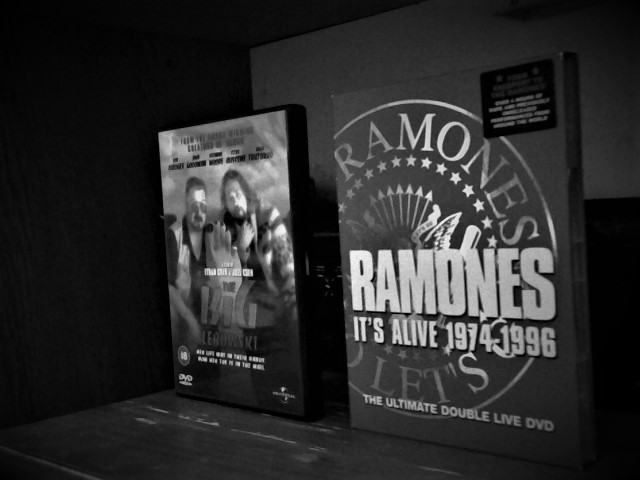

In [1]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow

img1 = cv.imread('image_l.jpg',0)
print("Imagem Esquerda")
cv2_imshow(img1)
img2 = cv.imread('image_r.jpg',0)
print("Imagem Direita")
cv2_imshow(img2)

Todas as ocorrências:


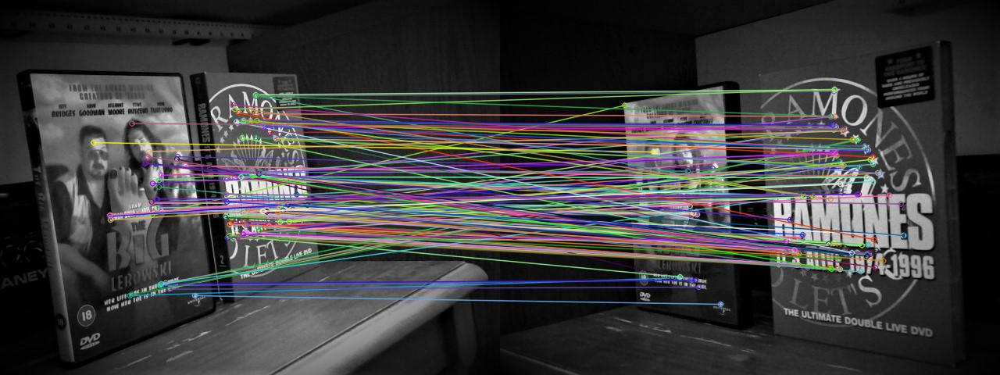

In [2]:
orb = cv.ORB_create()
kp1, des1 = orb.detectAndCompute(img1,None)
kp2, des2 = orb.detectAndCompute(img2,None)
bf = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1,des2)
matches = sorted(matches, key = lambda x:x.distance)
img3 = cv.drawMatches(img1,kp1,img2,kp2,matches,None, flags=2)
print("Todas as ocorrências:")
cv2_imshow(img3)

Somente as oito primeiras correspondências:
(336.0, 270.0) <--> (483.0, 221.0)
(312.0, 152.0) <--> (459.0, 179.0)
(289.0, 229.0) <--> (364.0, 340.0)
(370.0, 174.0) <--> (469.0, 330.0)
(356.0, 270.0) <--> (445.0, 169.0)
(315.0, 144.0) <--> (465.0, 348.0)
(343.0, 168.0) <--> (236.0, 363.0)
(341.0, 267.0) <--> (438.0, 222.0)


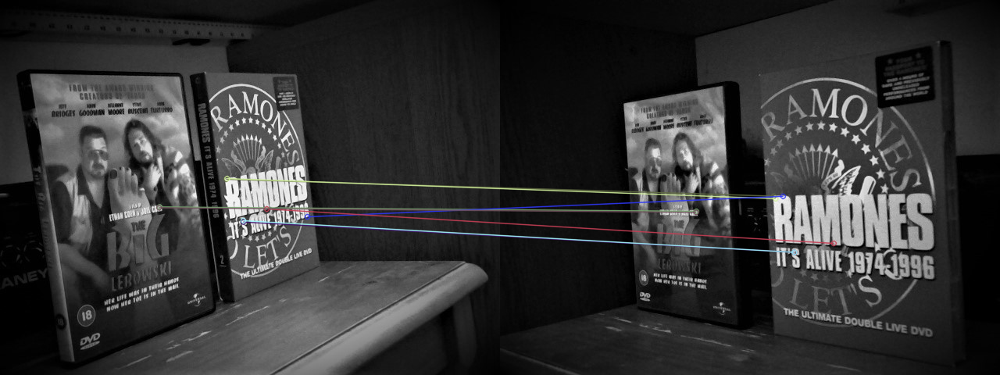

In [3]:
img3 = cv.drawMatches(img1,kp1,img2,kp2,matches[:8],None, flags=2)
print("Somente as oito primeiras correspondências:")
for i in range(8):
  print(kp1[i].pt,"<-->",kp2[i].pt)
cv2_imshow(img3)

In [4]:
x=[]
xl=[]
for i in range(8):
  x.append(kp1[i].pt)
  xl.append(kp2[i].pt)
F, _= cv.findFundamentalMat(np.array(x, dtype='float32'),np.array(xl, dtype='float32'),cv.FM_LMEDS)
print(F)

[[ 2.14649910e-05  2.94241162e-06 -7.15732839e-03]
 [-1.69404810e-05  2.21940435e-05  1.89049376e-03]
 [ 6.21101883e-04 -7.78931967e-03  1.00000000e+00]]


Não é possível obter a matriz fundamental com um número de amostras menor que 8.

**EX:** obter a matriz fundamental com um número maior de correspondências, ou seja, com um número de amostras maior que 8.

In [5]:
x=[]
xl=[]
for i in range(30):
  x.append(kp1[i].pt)
  xl.append(kp2[i].pt)
F, _= cv.findFundamentalMat(np.array(x, dtype='float32'),np.array(xl, dtype='float32'),cv.FM_LMEDS)
print(F)

[[ 4.08728862e-06  3.23461462e-07 -1.52247858e-03]
 [ 3.15524827e-06  1.67690669e-06 -1.47166748e-03]
 [-2.50646329e-03 -5.17949700e-04  1.00000000e+00]]


### <b> MATRIZ ESSENCIAL E </b>

A matriz fundamental E satisfaz a equação abaixo, onde K e K' são as matrizes das duas câmeras e, F, a matriz fundamental.

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/94797b318a9e805f6515cee74fa3de42ac35ee7a"> </img>
</center>

Se soubermos a matriz essencial E, podemos obter as matrizes associadas às câmeras. Uma maneira de fazer isto é supor que K seja a matriz identidade e, em função dela,determinar a matriz K'.

In [6]:
K=np.array([[1,0,0],
            [0,1,0],
            [0,0,1]], dtype='float32')
E,_=cv.findEssentialMat(np.array(x, dtype='float32'),np.array(xl, dtype='float32'),K)
print(E)

[[-1.02719334e-03 -2.52006515e-04  3.80604588e-01]
 [ 2.75865973e-03 -2.19858850e-03 -5.95926939e-01]
 [-2.86721206e-01  6.46359907e-01 -2.73670837e-03]]


**EX:** Analisando a influência no número de pontos correspondentes nas imagens para computar a matriz essencial.

In [13]:
x=[]
xl=[]

#precisa ser maior que 5
for i in range(6):
  x.append(kp1[i].pt)
  xl.append(kp2[i].pt)

K=np.array([[1,0,0],
            [0,1,0],
            [0,0,1]], dtype='float32')
E,_=cv.findEssentialMat(np.array(x, dtype='float32'),np.array(xl, dtype='float32'),K)
print(E)

[[-0.0013758   0.00352344 -0.48233807]
 [ 0.00102336 -0.003207    0.51703442]
 [ 0.43904043 -0.55427476 -0.00476963]]


Obtendo a matriz E, podemos decompô-la em fatores usando a decomposição SVD (Decomposição em Valores Singulares). A decomposição SVD permite decompor uma matriz M em três componentes:

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/f577effb716a33019b63f9072fd245bb2a751bdb"> </img>
</center>

Por exemplo, a matriz M mostrada abaixo

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/0d5d3df9cf619062481ab2a6b328467990152f1a"> </img>
</center>

possui a seguinte decomposição em valores singulares

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/73fdf5fe339a08566cccb833c860558092532f74"> </img>
</center>

A matriz do centro é sempre uma matriz diagonal, formada por autovalores. As matrizes U e V* são matrizes unitárias, isto é, multiplicado elas por elas mesmas, produzimos a matriz identidade:

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/a7f128976e087ec8136d54eeaab90a2eda2a09bc"> </img>
</center>
<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/43daa2de3e7835aba9c75c1eef02bbe5c2d6f687"> </img>
</center>

#### <b> EXERCÍCIO </b>

No link abaixo, temos a documentação da decomposição SVD do módulo numpy:

https://numpy.org/doc/stable/reference/generated/numpy.linalg.svd.html

Utilizando esta documentação, obtenha e exiba a decomposição SVD da matriz essencial E, calculada anteriormente.

In [14]:
import numpy as np

u, s, vh = np.linalg.svd(E, full_matrices=True)

print(u)
print(s)
print(vh)

[[-3.13361705e-03  6.82142819e-01  7.31212251e-01]
 [ 2.33088911e-03 -7.31208872e-01  6.82149656e-01]
 [ 9.99992374e-01  3.84197047e-03  7.01329317e-04]]
[7.07106781e-01 7.07106781e-01 8.88860715e-17]
[[ 6.20901666e-01 -7.83883085e-01 -2.90335353e-03]
 [-6.08485266e-16  3.70378398e-03 -9.99993141e-01]
 [ 7.83888462e-01  6.20897407e-01  2.29968565e-03]]


Para obter uma possível matriz de rotação de uma câmera e sua translação em relação a outra câmera, podemos usar as seguintes relações:

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/982105be58f296a050d9bd1be02ec12d1c578c21"> </img>
</center>

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/bc1799dbc7da928a0d4576f5b9ed5d21d955be72"> </img>
</center>

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/563ddbeb35c985502bc0bb0b0cc13178a2b68c43"> </img>
</center>

<center>
<img src="https://wikimedia.org/api/rest_v1/media/math/render/svg/f48a92bc850bdfa4b0e313281f1ba9ae8a0af0ac"> </img>
</center>

### <b> OBTENHA MATRIZ DE ROTAÇÃO E UM VETOR DE TRANSLAÇÃO PARA UMA DAS CÂMERAS </b>


In [15]:
R1, R2, T = cv.decomposeEssentialMat(E)
print(R1)
print(R2)
print(T)

[[ 0.99673246 -0.08070082 -0.00343254]
 [ 0.08072044  0.99671859  0.00602256]
 [ 0.00293525 -0.00627996  0.99997597]]
[[ 0.14964523  0.9887164   0.00679566]
 [ 0.98873805 -0.14962868 -0.0028851 ]
 [-0.00183572  0.00715086 -0.99997275]]
[[7.31212251e-01]
 [6.82149656e-01]
 [7.01329317e-04]]


## **AULA 18 - PROCESSO DE VISÃO ESTÉREO/DISPARIDADE/MAPA DE PROFUNDIDADE/RECONSTRUÇÃO 3D**

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

#### <b> CARGA DOS DADOS PARA RECONSTRUÇÃO 3D <b>

Esta sequencia de células é somente para descompactar o nosso arquivo de dados, formados pelas imagens e dados de calibração das câmeras. Em seguida, lemos os dados destes arquivos.

In [18]:
from zipfile import ZipFile
file_name = "data_road.zip"

with ZipFile(file_name, 'r') as zip:
  zip.extractall()

In [19]:
data_folder_left = "data_road/training/image_2/"
data_folder_right = "data_road/training_right/image_3/"
data_folder_calib = "data_road/training/calib/"
cat = ['uu', 'uum', 'um']
IDX_LEN = 6

In [20]:
idx_num = 1
cat_idx = 2
fname = cat[cat_idx]+'_'+str(idx_num).zfill(IDX_LEN)
img_fname = fname + '.png'
calib_fname = fname + '.txt'

In [21]:
img_left_color = cv2.imread(data_folder_left + img_fname)
img_right_color = cv2.imread(data_folder_right + img_fname)

In [22]:
img_left_bw = cv2.blur(cv2.cvtColor(img_left_color, cv2.COLOR_RGB2GRAY),(5,5))
img_right_bw = cv2.blur(cv2.cvtColor(img_right_color, cv2.COLOR_RGB2GRAY),(5,5))

A imagem capturada pela câmera esquerda é mostrada abaixo:

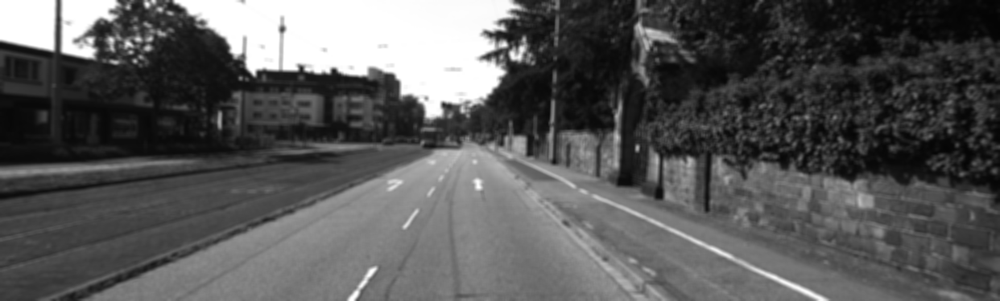

In [23]:
cv2_imshow(img_left_bw)

A imagem capturada pela câmera direita é mostrada abaixo:

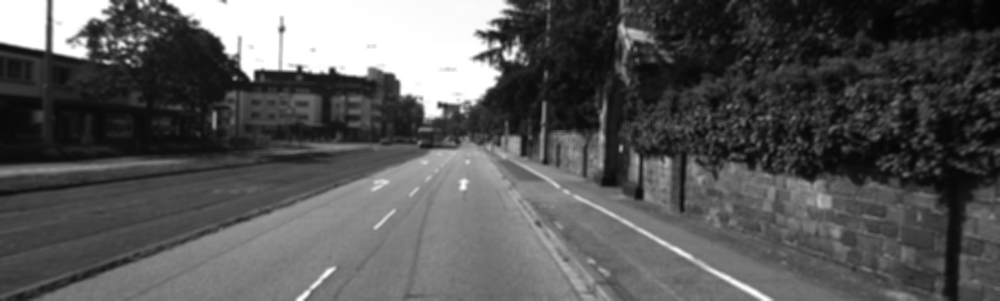

In [24]:
cv2_imshow(img_right_bw)

Abaixo, temos a leitura dos dados de calibração das câmeras:

In [25]:
matrix_type_1 = 'P2'
matrix_type_2 = 'P3'

calib_file = data_folder_calib + calib_fname
with open(calib_file, 'r') as f:
    fin = f.readlines()
    for line in fin:
        if line[:2] == matrix_type_1:
            calib_matrix_1 = np.array(line[4:].strip().split(" ")).astype('float32').reshape(3,-1)
        elif line[:2] == matrix_type_2:
            calib_matrix_2 = np.array(line[4:].strip().split(" ")).astype('float32').reshape(3,-1)


In [26]:
calib_matrix_1

array([[7.215377e+02, 0.000000e+00, 6.095593e+02, 4.485728e+01],
       [0.000000e+00, 7.215377e+02, 1.728540e+02, 2.163791e-01],
       [0.000000e+00, 0.000000e+00, 1.000000e+00, 2.745884e-03]],
      dtype=float32)

In [27]:
calib_matrix_2

array([[ 7.215377e+02,  0.000000e+00,  6.095593e+02, -3.395242e+02],
       [ 0.000000e+00,  7.215377e+02,  1.728540e+02,  2.199936e+00],
       [ 0.000000e+00,  0.000000e+00,  1.000000e+00,  2.729905e-03]],
      dtype=float32)

#### <b> CÁLCULO DE DISPARIDADES </b>

A disparidade é qualquer mudança entre a posição de objetos
no par de imagens, e é inversamente proporcional à distância do
objeto até a lente da câmera. Portanto a distância pode ser
calculada obtendo a disparidade de um par estéreo, e a disparidade
pode ser estimada através da correspondência dos objetos nas
imagens.

A OpenCV disponibiliza uma implementação do Algoritmo de Emparelhamento de Blocos (Bock Matching Algorithm). 

Referência: https://en.wikipedia.org/wiki/Block-matching_algorithm

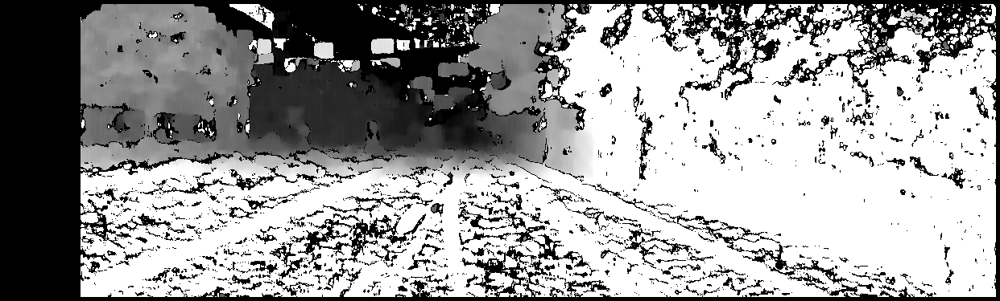

In [28]:
stereo = cv2.StereoBM_create(numDisparities=96, blockSize=11)
disparity = stereo.compute(img_left_bw,img_right_bw)
img = disparity.copy()
cv2_imshow(img)

#### <b>EXERCÍCIO</b>

Um dos parâmetros de configuração para cálculo de disparidades é o numDisparities. O que este parâmetro controla ? Por que ele precisa ser múltiplo de 16 ?

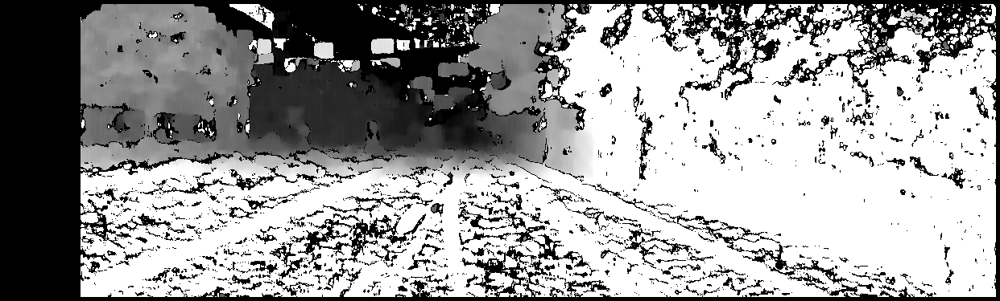

In [42]:
#controla o número de vizinhos na busca
#múltiplo de 16 pelo tipo de algoritmo que ele usa
#com numDisparities baixo, não consegue perceber muita variação
#maior numDisparities, percebe-se mais mudança 

stereo = cv2.StereoBM_create(numDisparities=96, blockSize=11)
disparity = stereo.compute(img_left_bw,img_right_bw)
img = disparity.copy()
cv2_imshow(img)

#### <b>EXERCÍCIO</b>

O segundo parâmetro é o blockSize... o que controla a configuração deste parâmetro ?

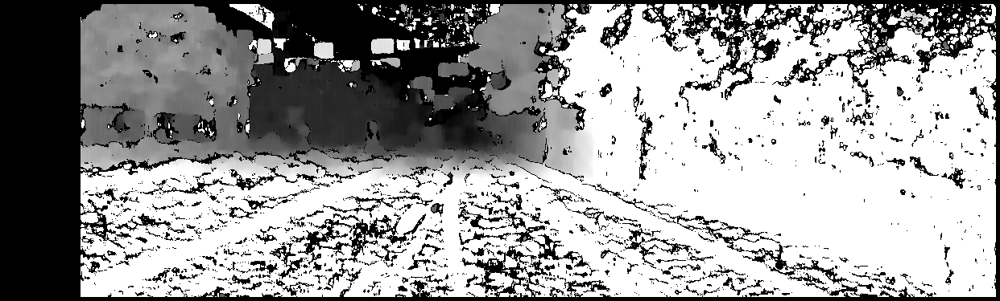

In [34]:
#relacionado ao tamanho do bloquinho que vamos buscar similaridade
#quanto maior o bloquinho, mais coisa estaremos olhando em conjunto
#precisa ser número ímpar
#quanto menor mais refinado

stereo = cv2.StereoBM_create(numDisparities=96, blockSize=11)
disparity = stereo.compute(img_left_bw,img_right_bw)
img = disparity.copy()
cv2_imshow(img)

#### <b> RECONSTRUÇÃO 3D </b>

A partir do mapa de disparidades, podemos obter a profundidade de cada ponto do par estéreo. Isto gera o chamado mapa de profundidade. 

<img src="https://www.researchgate.net/profile/Sing_Bing_Kang/publication/2313285/figure/fig1/AS:341573188505604@1458448802555/Relationship-between-the-baseline-b-disparity-d-focal-length-f-and-depth-z_W640.jpg"> </img>

Isto é feito pela função stereoRectify da OpenCV.

In [35]:
# Calculate depth-to-disparity
cam1 = calib_matrix_1[:,:3] # left image - P2
cam2 = calib_matrix_2[:,:3] # right image - P3

Tmat = np.array([0.54, 0., 0.])

rev_proj_matrix = np.zeros((4,4))

cv2.stereoRectify(cameraMatrix1 = cam1,cameraMatrix2 = cam2, \
                  distCoeffs1 = 0, distCoeffs2 = 0, \
                  imageSize = img_left_color.shape[:2], \
                  R = np.identity(3), T = Tmat, \
                  R1 = None, R2 = None, \
                  P1 =  None, P2 =  None, Q = rev_proj_matrix);


O resultado principal da stereoRectify é determinar a matriz inversa de projeção de uma das câmeras do setup de visão estéreo. Uma vez que tenhamos esta matriz, podemos reconstruir a estrutura 3D de qualquer objeto. 

In [36]:
points = cv2.reprojectImageTo3D(img, rev_proj_matrix)

#reflect on x axis
reflect_matrix = np.identity(3)
reflect_matrix[0] *= -1
points = np.matmul(points,reflect_matrix)

#extract colors from image
colors = cv2.cvtColor(img_left_color, cv2.COLOR_BGR2RGB)

#filter by min disparity
mask = img > img.min()
out_points = points[mask]
out_colors = colors[mask]

#filter by dimension
idx = np.fabs(out_points[:,0]) < 4.5
out_points = out_points[idx]
out_colors = out_colors.reshape(-1, 3)
out_colors = out_colors[idx]

print("Pontos Reconstruídos:")
print(points[0])

Pontos Reconstruídos:
[[ 20.57262802  -5.83382273  24.35189819]
 [ 20.53887749  -5.83382273  24.35189819]
 [ 20.50512695  -5.83382273  24.35189819]
 ...
 [-21.24362183  -5.83382273  24.35189819]
 [-21.27737236  -5.83382273  24.35189819]
 [-21.31112289  -5.83382273  24.35189819]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in matmul
  


#### <b> ARMAZENAMENTO DA NUVEM DE PONTOS </b>

A nuvem de pontos reconstruída anteriormente, pode ser armazenada de diversas maneiras. Uma das maneiras comuns é salvar os resultado no formato PLY.

Referência: https://en.wikipedia.org/wiki/PLY_(file_format)

In [37]:
def write_ply(fn, verts, colors):
    ply_header = '''ply
    format ascii 1.0
    element vertex %(vert_num)d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    end_header
    '''
    out_colors = colors.copy()
    verts = verts.reshape(-1, 3)
    verts = np.hstack([verts, out_colors])
    with open(fn, 'wb') as f:
        f.write((ply_header % dict(vert_num=len(verts))).encode('utf-8'))
        np.savetxt(f, verts, fmt='%f %f %f %d %d %d ')

write_ply('out.ply', out_points, out_colors)
print('%s saved' % 'out.ply')

out.ply saved


#### <b> VERIFICAÇÃO DOS PONTOS PROJETADOS </b>

Uma vez que tenhamos reconstruídos os pontos, podemos verificar a qualidade da reconstruída, reprojetando os pontos reconstruídos para produzir uma nova imgame.

In [38]:
reflected_pts = np.matmul(out_points, reflect_matrix)
projected_img,_ = cv2.projectPoints(reflected_pts, np.identity(3), np.array([0., 0., 0.]), \
                          cam2[:3,:3], np.array([0., 0., 0., 0.]))
projected_img = projected_img.reshape(-1, 2)

In [39]:
blank_img = np.zeros(img_left_color.shape, 'uint8')
img_colors = img_right_color[mask][idx].reshape(-1,3)

for i, pt in enumerate(projected_img):
    pt_x = int(pt[0])
    pt_y = int(pt[1])
    if pt_x > 0 and pt_y > 0:
        # use the BGR format to match the original image type
        col = (int(img_colors[i, 2]), int(img_colors[i, 1]), int(img_colors[i, 0]))
        cv2.circle(blank_img, (pt_x, pt_y), 1, col)

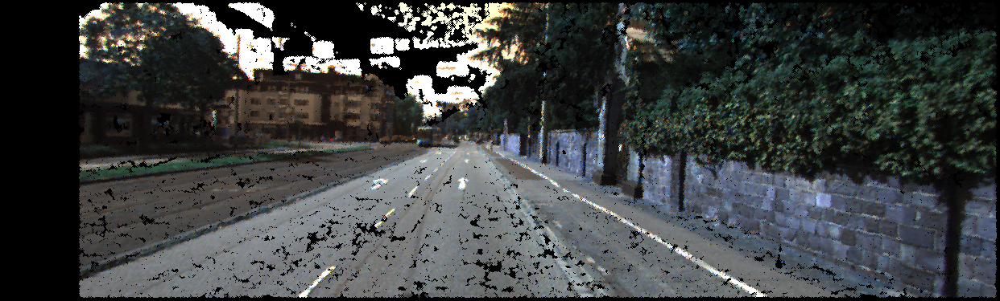

In [40]:
cv2_imshow(blank_img)

#### <b>EXERCÍCIO</b>

Como a geração do mapa de disparidades controla a qualidade dos pontos reconstruídos ? Faça experimentos para verificar como a qualidade do mapa de disparidades controla a qualidade da reconstrução.

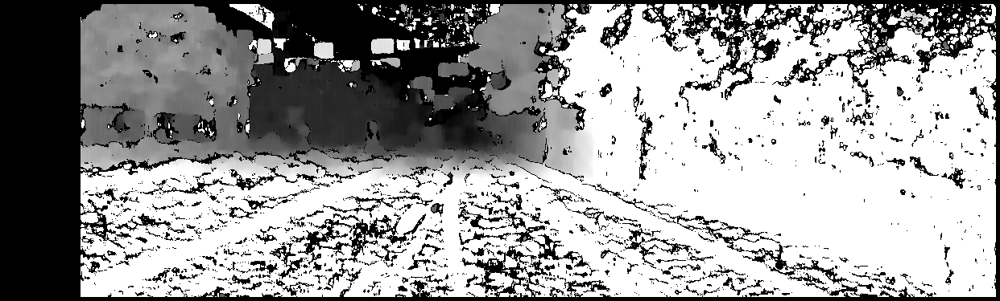

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in matmul


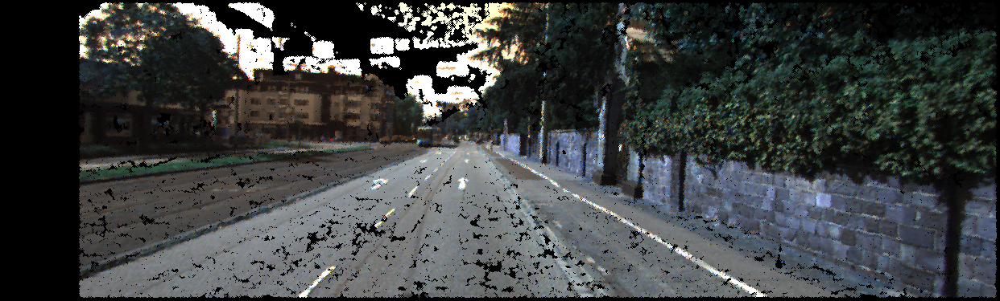

In [41]:
#com 16 a qualidade não fica muito boa
#experimentação
#bloco muito alto dá problema, perde muita coisa

stereo = cv2.StereoBM_create(numDisparities=96, blockSize=11)
disparity = stereo.compute(img_left_bw,img_right_bw)
img = disparity.copy()
cv2_imshow(img)

# Calculate depth-to-disparity
cam1 = calib_matrix_1[:,:3] # left image - P2
cam2 = calib_matrix_2[:,:3] # right image - P3

Tmat = np.array([0.54, 0., 0.])

rev_proj_matrix = np.zeros((4,4))

cv2.stereoRectify(cameraMatrix1 = cam1,cameraMatrix2 = cam2, \
                  distCoeffs1 = 0, distCoeffs2 = 0, \
                  imageSize = img_left_color.shape[:2], \
                  R = np.identity(3), T = Tmat, \
                  R1 = None, R2 = None, \
                  P1 =  None, P2 =  None, Q = rev_proj_matrix);

points = cv2.reprojectImageTo3D(img, rev_proj_matrix)

#reflect on x axis
reflect_matrix = np.identity(3)
reflect_matrix[0] *= -1
points = np.matmul(points,reflect_matrix)

#extract colors from image
colors = cv2.cvtColor(img_left_color, cv2.COLOR_BGR2RGB)

#filter by min disparity
mask = img > img.min()
out_points = points[mask]
out_colors = colors[mask]

#filter by dimension
idx = np.fabs(out_points[:,0]) < 4.5
out_points = out_points[idx]
out_colors = out_colors.reshape(-1, 3)
out_colors = out_colors[idx]


reflected_pts = np.matmul(out_points, reflect_matrix)
projected_img,_ = cv2.projectPoints(reflected_pts, np.identity(3), np.array([0., 0., 0.]), \
                          cam2[:3,:3], np.array([0., 0., 0., 0.]))
projected_img = projected_img.reshape(-1, 2)

blank_img = np.zeros(img_left_color.shape, 'uint8')
img_colors = img_right_color[mask][idx].reshape(-1,3)

for i, pt in enumerate(projected_img):
    pt_x = int(pt[0])
    pt_y = int(pt[1])
    if pt_x > 0 and pt_y > 0:
        # use the BGR format to match the original image type
        col = (int(img_colors[i, 2]), int(img_colors[i, 1]), int(img_colors[i, 0]))
        cv2.circle(blank_img, (pt_x, pt_y), 1, col)

cv2_imshow(blank_img)

## **AULA 19- INTRODUZIR OS CONCEITOS DE GEOMETRIA DE MÚLTIPLAS VISÕES, GEOMETRIA TRIFOCAL E TENSOR TRIFOCAL/PRATICAR COM O MÓDULO pymvg**

#### <b> GEOMETRIA COM TRÊS CÂMERAS (TRIFOCAL) E O TENSOR TRIFOCAL </b>

Assim como num sistema com duas imagens, podemos extrair informações sobre o cenário em 3D através da correspondência entre pontos, retas, tangentes e segmentos de curvas com três ou mais imagens. Isto é chamado genericamente de **Geometria de Múltiplas Visões**.

<center> <img src="https://miro.medium.com/max/810/1*wzzIPX7GiBOU-ON6kDp0Dg.jpeg"> </img> </center>

Nesta aula, trabalhemos com três visões, através de um sistema de três câmeras **(Geometria Trifocal)**. Nesta configuração três câmeras, temos a seguinte configuração:

<center> <img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Ft1.daumcdn.net%2Fcfile%2Ftistory%2F27575648586264FE04"> </img> </center>

Neste tipo de geometria, temos três linhas epipolares: l, l' e l''. A partir delas, definimos o **tensor trifocal**: 

<center> <img src="https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Ft1.daumcdn.net%2Fcfile%2Ftistory%2F24147A4B5862653424"> </img></center>

As matrizes de câmeras são calculadas a partir do tensor trifocal. Para calcular o tensor trifocal, precisamos de **seis pontos em cada imagem**   correspondentes nas três imagens. Observe que esta quantidade é menor que na **visão bifocal (visão estéreo)**, onde precisávamos de **8 pontos**. 

Detalhes da obtenção das câmeras podem ser obtidos no seguinte artigo: 

https://stuartheinrich.com/cv/els_robust_tensor.pdf 


#### <b> MÓDULO PYMVG </b>

O módulo pymvg (Python Multiple View Geometry) permite especificar configuração para geometria de múltiplas visões em Python. Este módulo pode ser encontrado no link abaixo: 

https://pymvg.readthedocs.io/en/latest/ 

Este módulo não é parte oficial da linguagem Python. Assim, precisamos instalá-lo via pip:

In [43]:
!pip install pymvg

     |████████████████████████████████| 44 kB 1.5 MB/s 
  Created wheel for pymvg: filename=pymvg-2.0.0-py3-none-any.whl size=45459 sha256=ed993ec212452154e2298ba253f3846e0f4c653d7e99aa810bf67b8e683bbb2d
  Stored in directory: /root/.cache/pip/wheels/53/63/56/8daadc8a194dc0ee832488f5f992ad15febc6642e8421d4a69
Successfully built pymvg


Já existem algumas configurações prontas para uso:

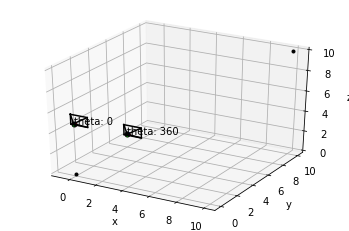

In [44]:
from pymvg.plot_utils import plot_camera
from pymvg.multi_camera_system import build_example_system
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

n=2
focal_distance=5.0
system = build_example_system(n=n,z=focal_distance)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for name in system.get_names():
    plot_camera( ax, system.get_camera(name), scale = focal_distance/5.0 )

if 1:
    # put some points to force mpl's view dimensions
    pts = np.array([[0,0,0],
                    [2*focal_distance, 2*focal_distance, 2*focal_distance]])
    ax.plot( pts[:,0], pts[:,1], pts[:,2], 'k.')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
plt.show()

Ou podemos especificar individualmente cada mâmera e construir a configuração manualmente:

In [45]:
import pymvg
from pymvg.camera_model import CameraModel
from pymvg.multi_camera_system import MultiCameraSystem

lookat = np.array( (0.0, 0.0, 0.0))
#Camera 1
center1 = np.array( (0.0, 0.0, 10.0) )
cam1 = CameraModel.load_camera_simple(name='cam1',fov_x_degrees=90,eye=center1,lookat=lookat)
#Camera 2
center2 = np.array( (10.0, 0.0, 0.0) )
cam2 = CameraModel.load_camera_simple(name='cam2',fov_x_degrees=90,eye=center2,lookat=lookat)
#Camera 3
center3 = np.array( (10.0, 10.0, 0.0) )
cam3 = CameraModel.load_camera_simple(name='cam3',fov_x_degrees=90,eye=center3,lookat=lookat)   
cameras = [cam1,cam2,cam3]
system = MultiCameraSystem(cameras)

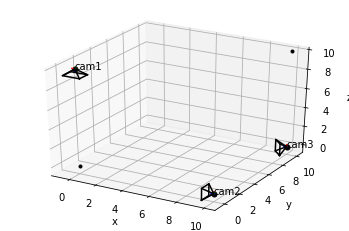

In [46]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for name in system.get_names():
    plot_camera( ax, system.get_camera(name), scale = focal_distance/5.0 )

if 1:
    # put some points to force mpl's view dimensions
    pts = np.array([[0,0,0],
                    [2*focal_distance, 2*focal_distance, 2*focal_distance]])
    ax.plot( pts[:,0], pts[:,1], pts[:,2], 'k.')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
plt.show()

#### <b> EXERCÍCIO </b>

Especifique uma configuração de câmeras em pymvg que permita escanear objetos como mostrado ma imagem abaixo:

<center> <img src="https://3be.com.br/wp-content/uploads/2019/10/EinScan-SE-feature-1.png"> </img></center>


In [47]:
import pymvg
from pymvg.camera_model import CameraModel
from pymvg.multi_camera_system import MultiCameraSystem

lookat = np.array( (0.0, 0.0, 0.0))
#Camera 1
center1 = np.array( (50.0, 0.0, 0.0) )
cam1 = CameraModel.load_camera_simple(name='cam1',fov_x_degrees=90,eye=center1,lookat=lookat)
#Camera 2
center2 = np.array( (0.0, 50.0, 0.0) )
cam2 = CameraModel.load_camera_simple(name='cam2',fov_x_degrees=90,eye=center2,lookat=lookat)
#Camera 3
center3 = np.array( (-50.0, 0.0, 0.0) )
cam3 = CameraModel.load_camera_simple(name='cam3',fov_x_degrees=90,eye=center3,lookat=lookat) 

#Camera 4
center2 = np.array( (0.0, -50.0, 0.0) )
cam4 = CameraModel.load_camera_simple(name='cam4',fov_x_degrees=90,eye=center2,lookat=lookat)

#Camera 5
center2 = np.array( (0.0, 0.0, 50.0) )
cam5 = CameraModel.load_camera_simple(name='cam5',fov_x_degrees=90,eye=center2,lookat=lookat)

cameras = [cam1,cam2,cam3,cam4,cam5]
system = MultiCameraSystem(cameras)

#### <b> EXERCÍCIO </b>

Especifique uma configuração de 3 câmeras focando na origem e com os seguintes centros: (20,0,0), (20,20,20) e (0,0,20).

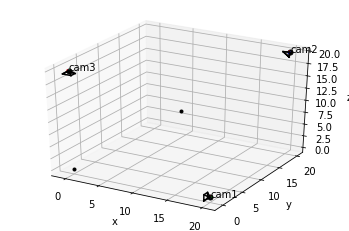

In [48]:
import pymvg
from pymvg.camera_model import CameraModel
from pymvg.multi_camera_system import MultiCameraSystem

lookat = np.array( (0.0, 0.0, 0.0))
#Camera 1
center1 = np.array( (20.0, 0.0, 0.0) )
cam1 = CameraModel.load_camera_simple(name='cam1',fov_x_degrees=90,eye=center1,lookat=lookat)
#Camera 2
center2 = np.array( (20.0, 20.0, 20.0) )
cam2 = CameraModel.load_camera_simple(name='cam2',fov_x_degrees=90,eye=center2,lookat=lookat)
#Camera 3
center3 = np.array( (0.0, 0.0, 20.0) )
cam3 = CameraModel.load_camera_simple(name='cam3',fov_x_degrees=90,eye=center3,lookat=lookat)   
cameras = [cam1,cam2,cam3]
system = MultiCameraSystem(cameras)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for name in system.get_names():
    plot_camera( ax, system.get_camera(name), scale = focal_distance/5.0 )

if 1:
    # put some points to force mpl's view dimensions
    pts = np.array([[0,0,0],
                    [2*focal_distance, 2*focal_distance, 2*focal_distance]])
    ax.plot( pts[:,0], pts[:,1], pts[:,2], 'k.')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
plt.show()

#### <b> EXERCÍCIO </b>

Considerando a configuração do exercício anterior, calcule as coordenadas dos pixels resultantes da projeção dos seis pontos abaixo nos planos de imagens de cada uma das câmeras: 

*   (0,0,0)
*   (1,1,0)
*   (1,1,1)
*   (1,0,1)
*   (0,1,1)
*   (0,0,1)

In [49]:
pt3d=[[0,0,0],
      [1,1,0],
      [1,1,1],
      [1,0,1],
      [0,1,1],
      [0,0,1]]

px1=cam1.project_3d_to_pixel(pt3d,distorted=False)
print(px1)
px2=cam2.project_3d_to_pixel(pt3d,distorted=False)
print(px2)
px3=cam2.project_3d_to_pixel(pt3d,distorted=False)
print(px3)

[[320.         240.        ]
 [320.         256.84210526]
 [336.84210526 256.84210526]
 [336.84210526 240.        ]
 [336.         256.        ]
 [336.         240.        ]]
[[320.         240.        ]
 [313.24278692 243.90127879]
 [320.         240.        ]
 [320.         232.19744241]
 [326.75721308 243.90127879]
 [326.64268405 236.16484458]]
[[320.         240.        ]
 [313.24278692 243.90127879]
 [320.         240.        ]
 [320.         232.19744241]
 [326.75721308 243.90127879]
 [326.64268405 236.16484458]]


#### <b> DESAFIO </b>

A partir de cada conjunto de pixels projetados, reconstrua a configuração 3D dos pontos que originaram estes pixels projetados em cada câmera.

In [50]:
pt3d_1=cam1.project_pixel_to_camera_frame(px1,distorted=False)
pt3d_1

array([[0.        , 0.        , 1.        ],
       [0.        , 0.05255883, 0.99861783],
       [0.05248639, 0.05248639, 0.99724137],
       [0.05255883, 0.        , 0.99861783],
       [0.04987547, 0.04987547, 0.99750934],
       [0.04993762, 0.        , 0.99875234]])

## **REVISÃO PF**

**QUESTÃO 01 (2.0 pontos)** Considere o seguinte programa em OpenCV/Python e sua aplicação na imagem. Descreva brevemente o que faz este programa.

In [51]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
img = cv.imread('jota.png', cv.IMREAD_GRAYSCALE)
_, mask=cv.threshold(img, 230, 255, cv.THRESH_BINARY_INV)
kernel=np.ones((3,3), np.uint8)
imgd=cv.dilate(mask, kernel)
imgc=cv.subtract(imgd,mask)

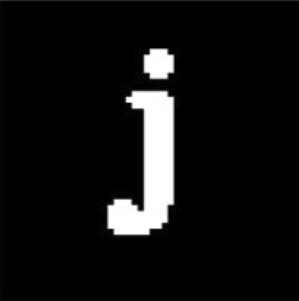

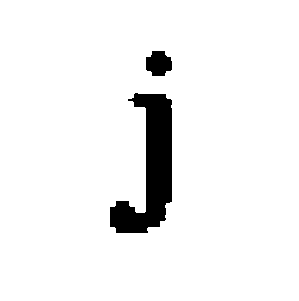

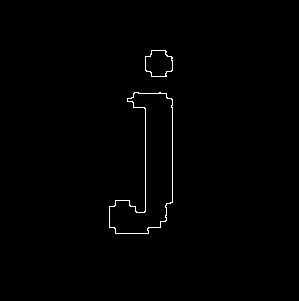

In [52]:
cv2_imshow(img)
cv2_imshow(imgd)
cv2_imshow(imgc)

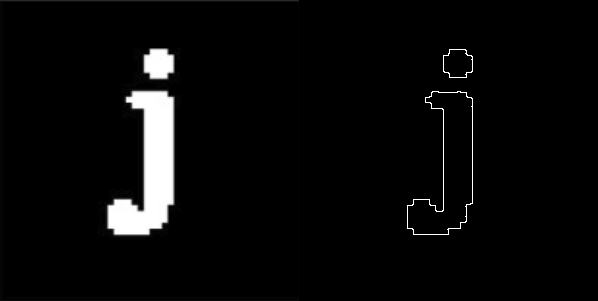

In [53]:
imge=cv.erode(mask, kernel)
imgc=cv.subtract(mask,imge)

#printar imagem lado a lado
cv2_imshow(np.hstack([img, imgc]))

O procedimento calcula o contorno da imagem img

**QUESTÃO 02 (2.0 pontos)** O código abaixo exibe uma imagem BGR, com acesso a um pixel individual. 

[202 206 168]


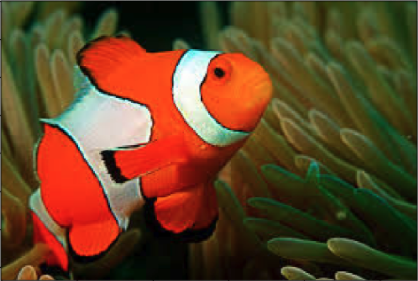

In [54]:
import cv2 as cv
import numpy as np
nemo = cv.imread('nemo.png')
print(nemo[100][100])
cv2_imshow(nemo)

Modifique este código para segmentar somente a parte laranja do peixe, produzindo um resultado semelhante ao mostrado abaixo. Observe que, na imagem original, temos vários tons de laranja.

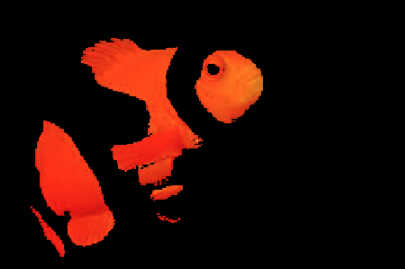

In [55]:
seg = cv.imread('seg.png')
cv2_imshow(seg)

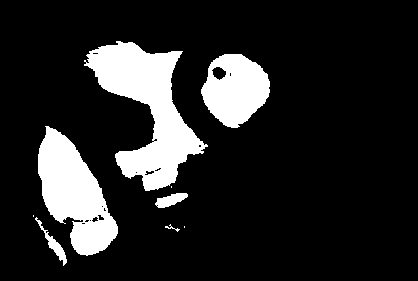

In [56]:
#converter de BGR para RGB
nemorgb = cv.cvtColor(nemo, cv.COLOR_BGR2RGB)

#converter imagem para HSV
hsv_nemo = cv.cvtColor(nemorgb, cv.COLOR_RGB2HSV)

#definir limites mínimos e máximos para os valores da cor laranja
light_orange = (1, 190, 200)
dark_orange = (18, 255, 255)

#segmentar a imagem pelas cores
mask = cv.inRange(hsv_nemo, light_orange, dark_orange)
cv2_imshow(mask)

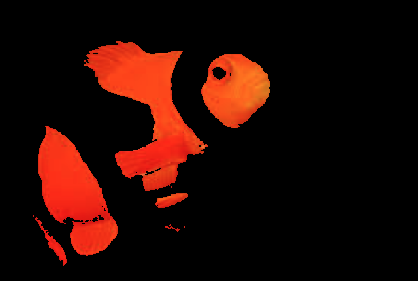

In [57]:
#usar máscara para segmentar
w,h,_=nemo.shape
for i in range(0,w):
  for j in range(0,h):
    if mask[i,j]!=255: #mantemos somente as cores correspondentes às máscaras
      nemo[i,j]=0
cv2_imshow(nemo)

**QUESTÃO 03(3.0 pontos)** Abaixo, temos duas notas e duas moedas do sistema financeiro brasileiro. Partindo da leitura da imagem abaixo, faça a segmentação das moedas e das notas. As moedas devem ser identificadas por círculos e, as notas, por retângulos.

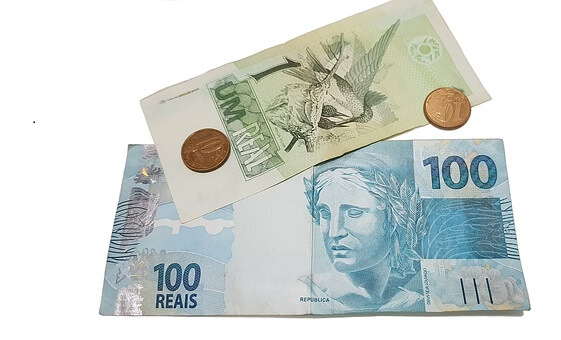

In [58]:
import cv2 as cv
import numpy as np

img = cv.imread('notasmoedas.jpg')
cv2_imshow(img)

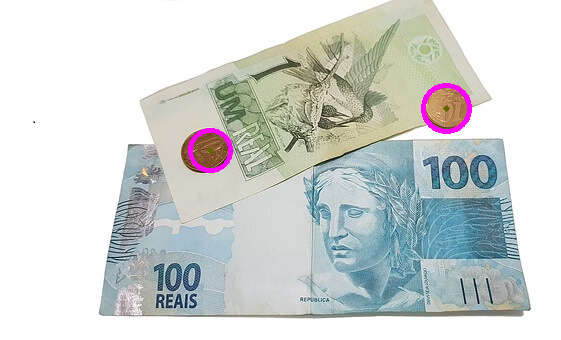

In [59]:
img = cv.imread('notasmoedas.jpg')
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
gray = cv.medianBlur(gray, 7)
rows = gray.shape[0]
#Documentação de HoughCircles: https://docs.opencv.org/4.x/dd/d1a/group__imgproc__feature.html#ga47849c3be0d0406ad3ca45db65a25d2d
circles = cv.HoughCircles(gray, cv.HOUGH_GRADIENT, 1, rows / 8,param1=100, param2=30, minRadius=8, maxRadius=46)
if circles is not None:
        circles = np.uint16(np.around(circles))
        for i in circles[0, :]:
            center = (i[0], i[1])
            # centro do círculo
            cv.circle(img, center, 1, (0, 100, 100), 3)
            # contorno do círculo
            radius = i[2]
            cv.circle(img, center, radius, (255, 0, 255), 3)
cv2_imshow(img)

#para as cédulas: pesquisar sobre HoughLines
#documentação HoughLines: https://docs.opencv.org/3.4/d9/db0/tutorial_hough_lines.html
